<h2>2<sup>η</sup> ΕΡΓΑΣΤΗΡΙΑΚΗ ΑΣΚΗΣΗ</h2>
<h3>Ανάλυση Κοινωνικής Δομής σε Τεχνητές και Πραγματικές Σύνθετες Τοπολογίες Δικτύων</h3>
<p style=text-align:justify>Στην παρούσα άσκηση θα αναλυθούν τεχνητές και πραγματικές τοπολογίες σύνθετων δικτύων με βάση τις μετρικές που χρησιμοποιήθηκαν στην προηγούμενη άσκηση και κάποιες τεχνικές που έχουν ως στόχο την εύρεση κοινωνικής δομής. Συγκεκριμένα, θα χρησιμοποιηθούν και θα συγκριθούν διάφοροι αλγόριθμοι εντοπισμού κοινοτήτων σε γράφους δικτύων που προκύπτουν από πραγματικά δεδομένα καθώς και στους συνθετικούς γράφους της πρώτης εργαστηριακής άσκησης.</p>

In [1]:
%matplotlib inline

import matplotlib
import networkx as nx
import random
import matplotlib.pyplot as plt
import numpy as np
import scipy as sp
from sklearn.cluster import SpectralClustering
import statistics
from IPython.display import display, Markdown, Latex
import time

<h3>Α. Μελέτη πραγματικών τοπολογιών</h3>
<p style=text-align:justify>Στο παρόν ερώτημα θα μελετήσετε και θα αποκτήσετε αίσθηση της τοπολογικής δομής πραγματικών δικτύων. Πιο συγκεκριμένα, για τις τοπολογίες που φαίνονται στον <b>πίνακα 1</b>, να βρεθούν και να δειχθούν:</p>
<ol>
    <li>Η κατανομή του βαθμού κόμβου και ο μέσος βαθμός κάθε τοπολογίας.</li>
    <li>Η κατανομή του συντελεστή ομαδοποίησης κόμβου και ο μέσος συντελεστής ομαδοποίησης κάθε τοπολογίας.</li>
    <li>Η κατανομή της κεντρικότητας εγγύτητας και η μέση κεντρικότητα εγγύτητας κάθε τοπολογίας.</li>
</ol>
<p style=text-align:justify>Να συγκριθούν τα αποτελέσματα σε σχέση με αυτά των συνθετικών τοπολογιών. Να χαρακτηρίσετε τον τύπο κάθε μίας από τις πραγματικές τοπολογίες με βάση τους τύπους δικτύων που εξετάστηκαν στην πρώτη εργαστηριακή άσκηση.</p>

<table style=width:100%>
    <caption>Πίνακας <b>1</b>: Πραγματικές τοπολογίες</a></caption>
<tr>
    <th style=text-align:left>Τοπολογία</th>
    <th style=text-align:left>Αρχείο</th>
    <th style=text-align:left>Περιγραφή</th>
</tr>
<tr>
    <td style=text-align:left>American College Football</td>
    <td style=text-align:left><a style=text-decoration:none href='http://www-personal.umich.edu/~mejn/netdata/football.zip'>football.gml</a></td>
    <td style=text-align:left><p style=text-align:justify> The file <b>football.gml</b> contains the network of American football games between Division IA colleges during regular season Fall 2000, as compiled by M. Girvan and M. Newman. The nodes have values that indicate to which conferences they belong.</p>
    </td>
</tr>  
<tr>
    <td style=text-align:left>Game of Thrones - season 5</td>
    <td style=text-align:left><a style=text-decoration:none href='https://networkofthrones.wordpress.com/the-series/season-5/'>GoT</a></td>
    <td style=text-align:left><p style=text-align:justify> The season 5 <b>GoT</b> network represents the interactions between the characters of Game of Thrones in season 5. The season 5 network has 118 nodes (characters) and 394 weighted edges, corresponding to 5,139 interactions. Data can be found here: <a style=text-decoration:none href='https://raw.githubusercontent.com/mathbeveridge/gameofthrones/master/data/got-s5-edges.csv'>GoT_data</a></p>
</tr> 
<tr>
    <td style=text-align:left>email-Eu-core</td>
    <td style=text-align:left><a style=text-decoration:none href='https://snap.stanford.edu/data/email-Eu-core.html'>email-eu-core</a></td>
    <td style=text-align:left><p style=text-align:justify> The network <b>email-Eu-core</b> was generated using email data from a large European research institution. There is an edge (u, v) in the network if person u sent person v at least one email. The e-mails only represent communication between institution members (the core) and the dataset does not contain incoming messages from or outgoing messages to the rest of the world. The dataset also contains "ground-truth" community memberships of the nodes. Each individual belongs to exactly one of 42 departments at the research institute. </p>
</tr> 
    
</table>

<h4>Παραγωγή συνθετικών τοπολογιών</h4> 
<p>Προσοχή! Τα δίκτυα που θα παράξετε θα πρέπει να είναι συνδεδεμένα.</p>

In [2]:
n=80
d=4
M=300
R=0.25
p=0.3
k=4

seedno=5

random.seed(seedno)

REG = nx.watts_strogatz_graph(n,d,0,seedno)
print(nx.is_connected(REG))

RGER =  nx.gnm_random_graph(n,M,seed=seedno,directed=False)
print(nx.is_connected(RGER))

R = 0.6
RGG = nx.random_geometric_graph(n,R,seedno)
# while not nx.is_connected(RGG):
#     seedno2 = random.randint(2,10000)
#     random.seed(seedno2)
#     RGG = nx.random_geometric_graph(n,0.5,seedno2)
print(nx.is_connected(RGG))

SF = nx.barabasi_albert_graph(n,d,seed=seedno)
print(nx.is_connected(SF))

SW = nx.watts_strogatz_graph(n,d,p) 
print(nx.is_connected(SW))

True
True
True
True
True


<h4>Εισαγωγή και οπτικοποίηση πραγματικών τοπολογιών.</h4>

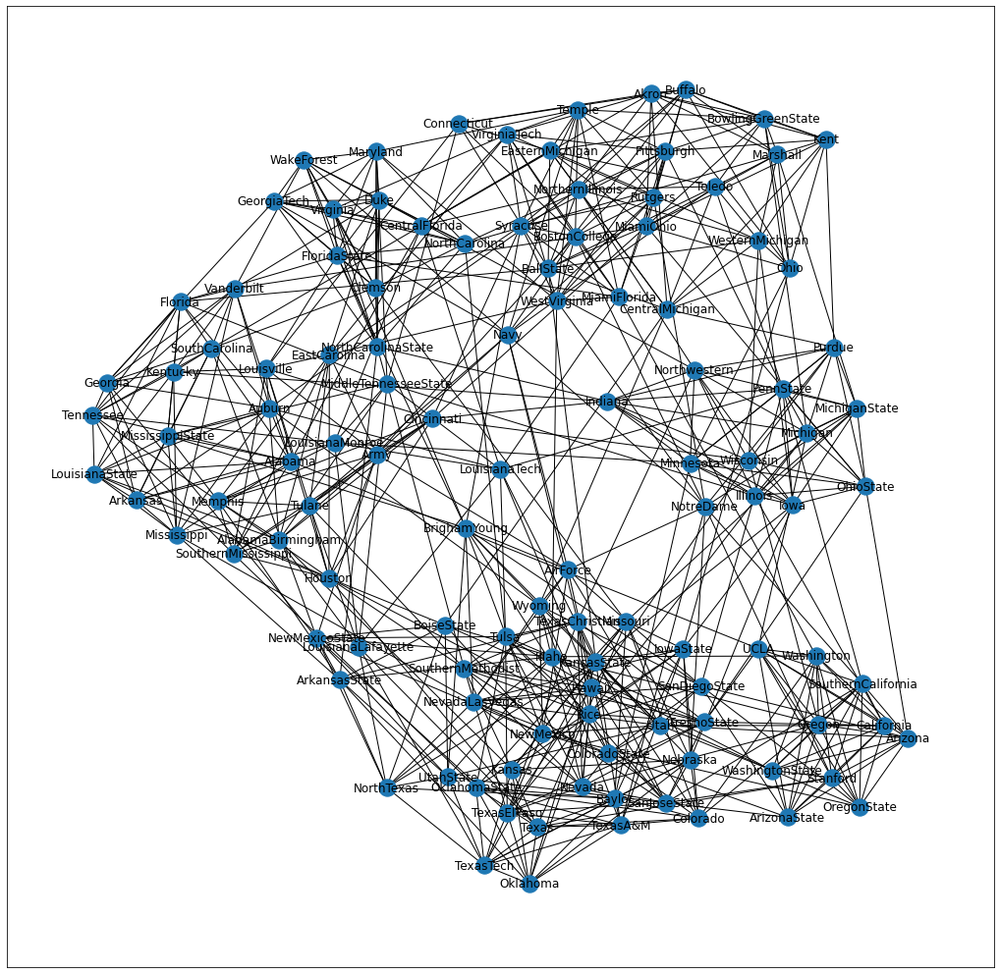

In [3]:
#football network
football=nx.read_gml(r"football.gml")
fig, ax = plt.subplots(figsize=(18,18))
nx.draw_networkx(football,ax=ax)

In [228]:
# for edge in football.edges:
#     print(edge)

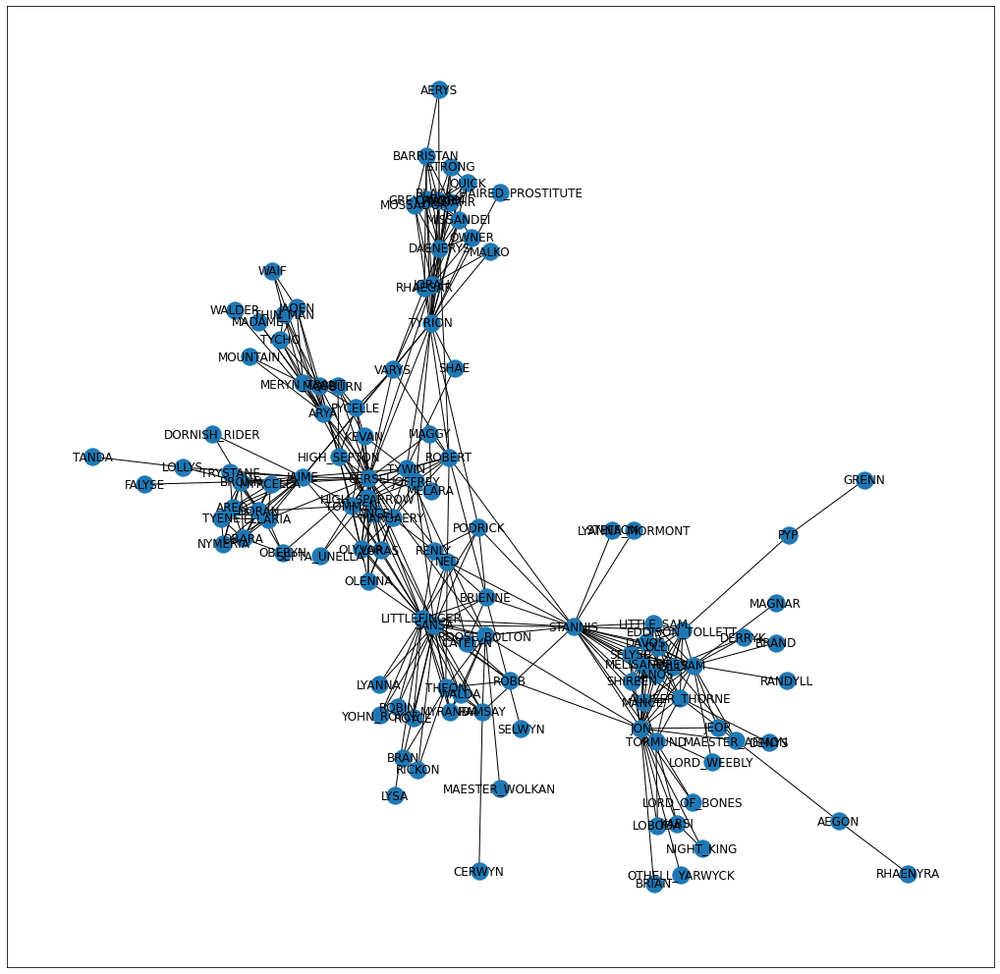

In [4]:
#Game of thrones network
import csv
got=nx.Graph()
with open('got_s5.csv') as csv_file:
    csv_reader = csv.reader(csv_file, delimiter=',')
    line_count = 0
    next(csv_reader)
    for row in csv_reader:
        got.add_edge(row[0],row[1])
        line_count += 1

fig, ax = plt.subplots(figsize=(18,18))
nx.draw_networkx(got,ax=ax)

#### Προσοχή! Θα μελετήσετε τη μεγαλύτερη συνδεδεμένη συνιστώσα του δικτύου email-Eu-core, αφού πρώτα αφαιρέσετε τα self-loops. Μπορείτε να κάνετε χρήση των συναρτήσεων connected_components, subgraph, remove_edges_from του networkx.

In [5]:
#email-Eu-core network
eu=nx.read_edgelist("email-Eu-core.txt",create_using=nx.Graph())

In [6]:
# find largest connected component
largest_con_comp = max(nx.connected_components(eu), key=len)

# find induced subgraph
largest_con_subgraph_eu = eu.subgraph(largest_con_comp)

Edges in largest connected component before removing self loops: 16687
Edges in largest connected component after removing self loops: 16064


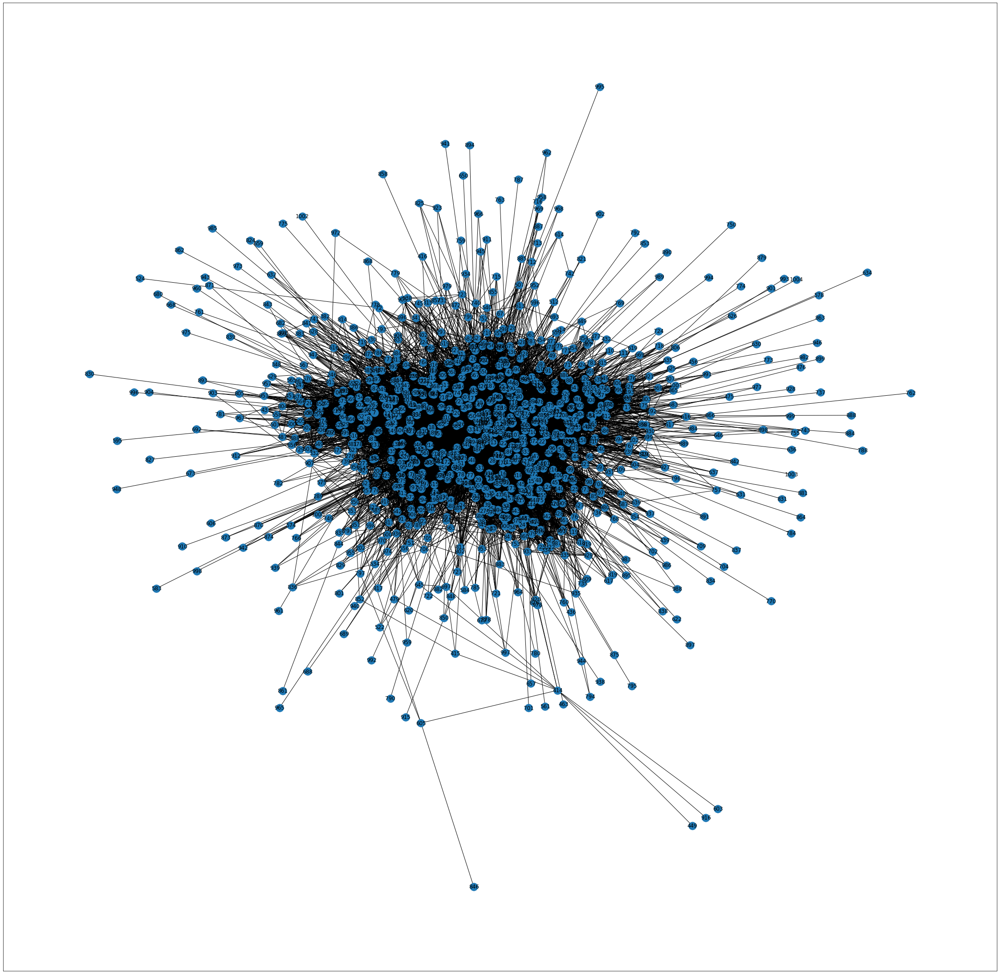

In [7]:
# copy graph to remove self loops 
eu_coppied = eu.copy()

# find largest connected component
largest_con_comp_coppied = max(nx.connected_components(eu_coppied), key=len)

# find induced subgraph
largest_con_subgraph_eu_coppied = eu_coppied.subgraph(largest_con_comp_coppied)
print(f"Edges in largest connected component before removing self loops: {len(largest_con_subgraph_eu_coppied.edges)}")

# find self loops
self_loops = []
for node in largest_con_subgraph_eu_coppied.nodes:
    if (node, node) in largest_con_subgraph_eu_coppied.edges:
        self_loops.append((node,node))

eu_coppied.remove_edges_from(self_loops)
print(f"Edges in largest connected component after removing self loops: {len(largest_con_subgraph_eu_coppied.edges)}")

fig, ax = plt.subplots(figsize=(40,40))
nx.draw_networkx(largest_con_subgraph_eu_coppied,ax=ax)

In [220]:
# for node in set(eu_coppied.nodes)-set(largest_con_subgraph_eu_coppied.nodes):
#     print(node)

<h4>Μελέτη βαθμού κόμβου για πραγματικές και συνθετικές τοπολογίες.</h4>

In [9]:
# function that plots degree distribution and return mean degree

def find_degree(G):
    degs = G.degree
    degrees = [b for (a,b) in degs]
    plt.hist(degrees, color='magenta')
    plt.title("Distribution of Degrees", fontsize=15)
    plt.xlabel("Degree", fontsize=13)
    plt.ylabel("#nodes", fontsize=13)
    plt.show()
    
    return statistics.mean(degrees), statistics.variance(degrees)

_Πραγματικές Τοπολογίες:_

Football


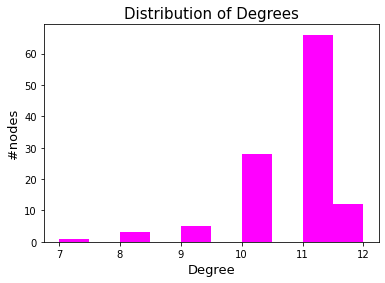

Mean Degree: 10.660869565217391


In [225]:
# football 
print('Football')
mmean, _ = find_degree(football)
print(f"Mean Degree: {mmean}")

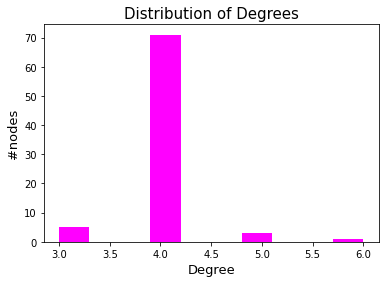

In [234]:
SW_new = nx.watts_strogatz_graph(n,d,0.02) 
mmean, _ = find_degree(SW_new)

GoT


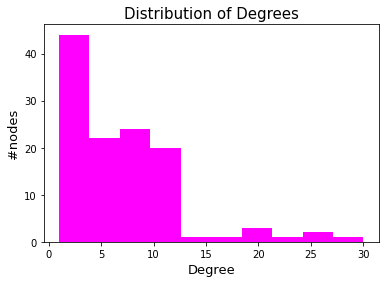

Mean Degree: 6.65546218487395


In [11]:
# Game of Throwns
print('GoT')
mmean, _ = find_degree(got)
print(f"Mean Degree: {mmean}")

EU


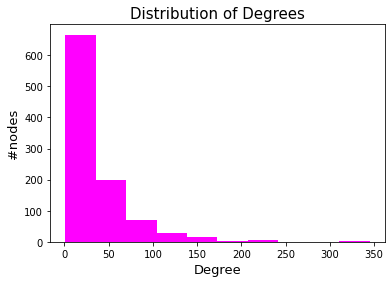

Mean Degree: 32.5841784989858


In [12]:
# EU
print('EU')
mmean, _ = find_degree(largest_con_subgraph_eu_coppied)
print(f"Mean Degree: {mmean}")

_Συνθετικές Τοπολογίες:_

REG


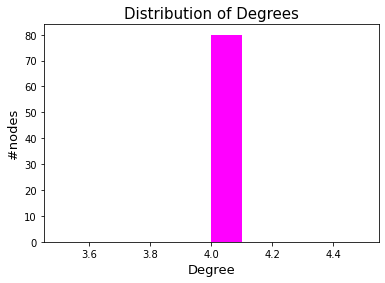

Mean Degree: 4


In [13]:
# REG
print('REG')
mmean, _ = find_degree(REG)
print(f"Mean Degree: {mmean}")

RGER


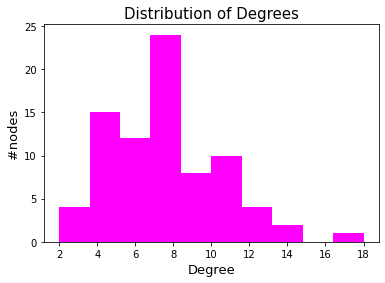

Mean Degree: 7.5


In [14]:
# RGER
print('RGER')
mmean, _ = find_degree(RGER)
print(f"Mean Degree: {mmean}")

RGG


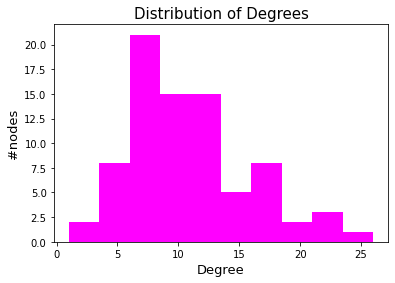

Mean Degree: 10.575


In [15]:
# RGG
print('RGG')
mmean, _ = find_degree(RGG)
print(f"Mean Degree: {mmean}")

SF


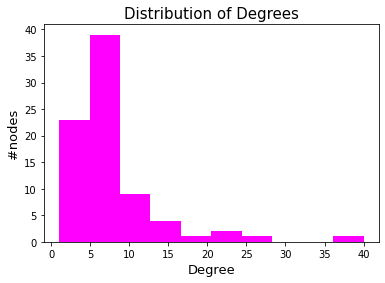

Mean Degree: 7.6


In [16]:
# SF
print('SF')
mmean, _ = find_degree(SF)
print(f"Mean Degree: {mmean}")

SW


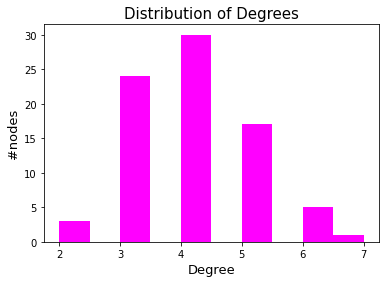

Mean Degree: 4


In [17]:
# SW
print('SW')
mmean, _ = find_degree(SW)
print(f"Mean Degree: {mmean}")

<h4>Μελέτη συντελεστή ομαδοποίησης για πραγματικές και συνθετικές τοπολογίες</h4>

In [18]:
# function that plots cc and return cc statistics

def cc(graph):
    # get clustering coefficient
    GraphCC = dict(nx.clustering(graph))
    vals = list(GraphCC.values())
    
    # plot
    fig, ax = plt.subplots()
    ax.hist(vals, np.linspace(0,1, 10), color='magenta')
    ax.set_xticks([i/10 for i in range(11)])

    plt.title("Clustering Coefficient Distribution", fontsize=15)
    plt.xlabel("Clustering Coefficient", fontsize=13)
    plt.ylabel("#nodes", fontsize=13)
    plt.show()
    
    # mean and var
    mmean = statistics.mean(vals) 
    vvar = statistics.variance(vals)
    
    mmax, mmin = vals.index(max(vals)), vals.index(min(vals)) 
    return mmean, vvar, mmax, mmin

_Πραγματικές Τοπολογίες:_

Football


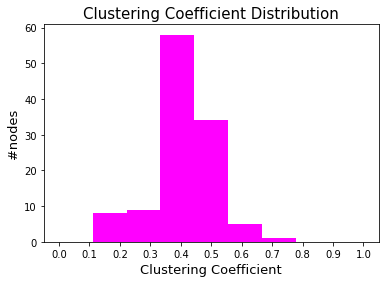

Mean CC: 0.403216011042098


In [19]:
# Football
print('Football')
mmean, _, _, _ = cc(football)
print(f"Mean CC: {mmean}")

GoT


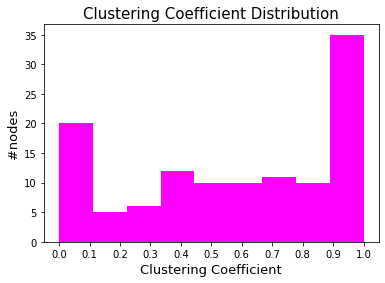

Mean CC: 0.5744036387164707


In [20]:
# GoT
print('GoT')
mmean, _, _, _ = cc(got)
print(f"Mean CC: {mmean}")

EU


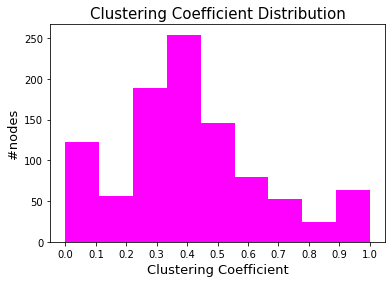

Mean CC: 0.4070504475195386


In [21]:
# EU
print('EU')
mmean, _, _, _ = cc(largest_con_subgraph_eu_coppied)
print(f"Mean CC: {mmean}")

_Συνθετικές Τοπολογίες:_

RGE


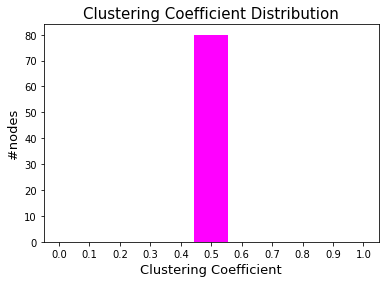

Mean CC: 0.5


In [22]:
# REG
print('RGE')
mmean, _, _, _ = cc(REG)
print(f"Mean CC: {mmean}")

RGER


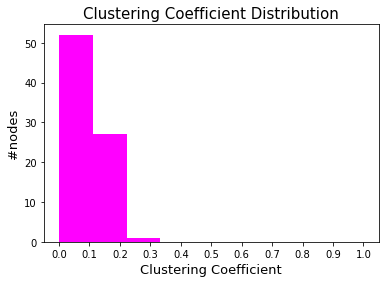

Mean CC: 0.08497775916893564


In [23]:
# RGER
print('RGER')
mmean, _, _, _ = cc(RGER)
print(f"Mean CC: {mmean}")

RGG


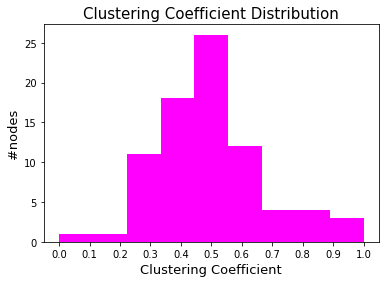

Mean CC: 0.49414340756852365


In [24]:
# RGG
print('RGG')
mmean, _, _, _ = cc(RGG)
print(f"Mean CC: {mmean}")

SF


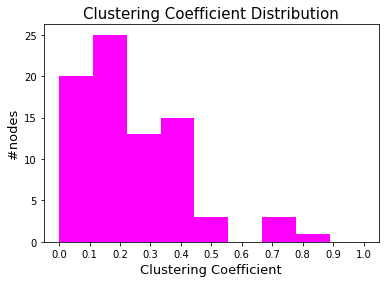

Mean CC: 0.22922761606585135


In [25]:
# SF
print('SF')
mmean, _, _, _ = cc(SF)
print(f"Mean CC: {mmean}")

SW


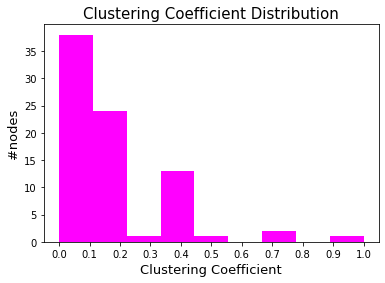

Mean CC: 0.1568452380952381


In [26]:
# SW
print('SW')
mmean, _, _, _ = cc(SW)
print(f"Mean CC: {mmean}")

<h4>Μελέτη κεντρικότητας εγγύτητας για πραγματικές και συνθετικές τοπολογίες </h4>

In [27]:
# function that plots closeness centrality and returns its mean value

def find_closeness(G):
    close_cen = nx.closeness_centrality(G)
    close_cen_values = [round(item, 10) for item in close_cen.values()]
    plt.hist(close_cen_values, color='magenta')
    plt.title("Distribution of Closeness Centrality", fontsize=15)
    plt.xlabel("Closeness Centrality",fontsize=13)
    plt.ylabel("#nodes",fontsize=13)
    plt.show()
    return statistics.mean(close_cen_values), \
            statistics.variance(close_cen_values)

_Πραγματικές τοπολογίες_:

Football


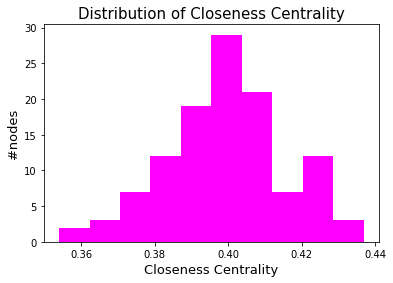

Mean Closeness Centrality: 0.399319078246087


In [28]:
# football
print('Football')
mmean, _ = find_closeness(football)
print(f"Mean Closeness Centrality: {mmean}")

GoT


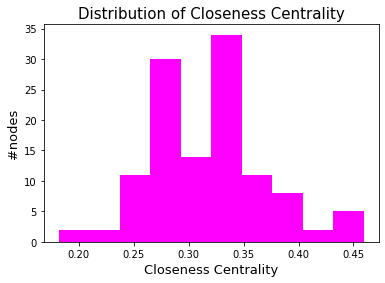

Mean Closeness Centrality: 0.31905170483361345


In [29]:
# GoT
print('GoT')
mmean, _ = find_closeness(got)
print(f"Mean Closeness Centrality: {mmean}")

EU


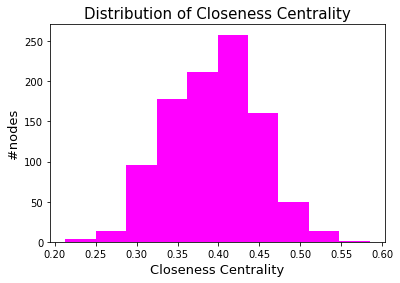

Mean Closeness Centrality: 0.39446404120862066


In [30]:
# EU
print('EU')
mmean, _ = find_closeness(largest_con_subgraph_eu_coppied)
print(f"Mean Closeness Centrality: {mmean}")

_Συνθετικές Τοπολογίες:_

REG


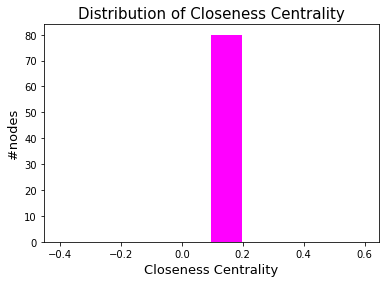

Mean Closeness Centrality: 0.0963414634


In [31]:
# REG
print('REG')
mmean, _ = find_closeness(REG)
print(f"Mean Closeness Centrality: {mmean}")

RGER


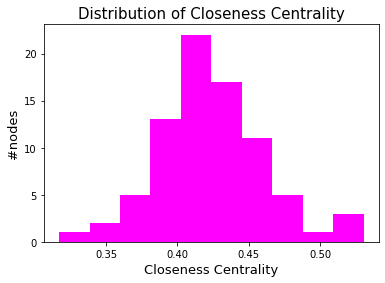

Mean Closeness Centrality: 0.4242297800925


In [32]:
# RGER
print('RGER')
mmean, _ = find_closeness(RGER)
print(f"Mean Closeness Centrality: {mmean}")

RGG


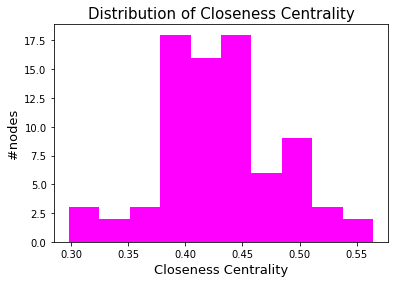

Mean Closeness Centrality: 0.42981828743


In [33]:
# RGG
print('RGG')
mmean, _ = find_closeness(RGG)
print(f"Mean Closeness Centrality: {mmean}")

SF


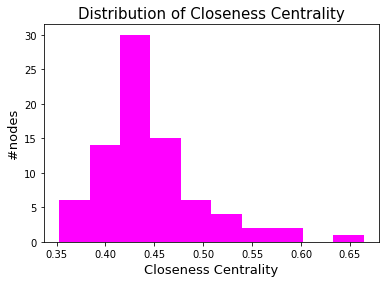

Mean Closeness Centrality: 0.446445383785


In [34]:
# SF
print('SF')
mmean, _ = find_closeness(SF)
print(f"Mean Closeness Centrality: {mmean}")

SW


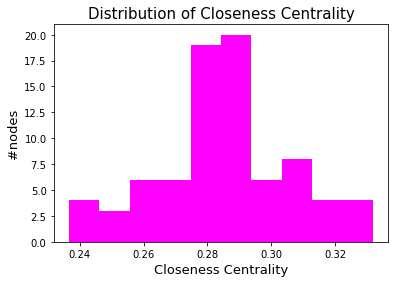

Mean Closeness Centrality: 0.28575810067375


In [35]:
# SW
print('SW')
mmean, _ = find_closeness(SW)
print(f"Mean Closeness Centrality: {mmean}")

**Χαρακτηρισμός Τύπου Τοπολογίας για τους πραγματικούς Γράφους**

* Ο Γράφος **American College Football** δεν έχει πολύ έντονα χαρακτηριστικά που να θυμίζουν συνθετική τοπολογία. Ωστόσο θα μπορούσαμε να πούμε ότι έχει χαρακτήρα Small-World δικτύου. Αυτό προκύπτει κυρίως από την κατανομή βαθμών κόμβων, η οποία παρουσιάζει μεγάλη συγκέντρωση γύρω από μία τιμή βαθμού, ενώ έχει σημαντικά μικρότερες ομάδες κόμβων που συγκεντρώνονται σε βαθμούς γύρω από τον πιο συνηθισμένο.


* O **Game of Thrones - Season 5** έχει αρκετά ξεκάθαρο χαρακτήρα Scale Free δικτύου. Αυτό και πάλι προκύπει κυρίως από την κατανομή βαθμών κόμβων, η οποία είναι τύπου Power-Law, αν και όχι πολύ απότομου. Η κατανομή clustering coefficient δεν ταιριάζει ιδιαίτερα με κάποια από τις γνωστές. Τέλος η κατανομή Closeness Centrality θυμίζει σε έναν βαθμό αυτή του Small World συνθετικού δικτύου, οπότε μπορύμε να πούμε ότι ο γράφος έχει και κάποια small-world χαρακτηριστικά.


* Ο **Email EU-core** γράφος έχει την πιο έντονη Scale-Free συμπεριφορά, όσον αφορά την κατανομή βαθμώμ κόμβων (απότομος Power-Law). Οι κατανομές Clustering Coefficient και Closeness Centrality έχουν και αυτές κοινά με τις αντίστοιχες κατανομές του συνθετικού Scale-Free Δικτύου αν και παρούσιάζουν λιγότερο απότομα χαρακτηριστικά. Αξίζει να παρατηρήσουμε επίσης ότι οι δύο τελετυταίες κατανομές έχουν αρκετά κοινά χαρακτηριστικά και με τις αντίστοιχες του τυχαίου γράφου (RGER).

<h3>B. Εξοικείωση με τα εργαλεία εντοπισμού κοινοτήτων</h3>
<ol>
<li>Χρησιμοποιώντας τις συναρτήσεις του <b>πίνακα 2</b> για κάθε <u>πραγματικό</u> (<b>πίνακας 1</b>) και <u>συνθετικό</u> (από την <b>άσκηση 1</b>) δίκτυο:</p>
<ol>
    <li>να οπτικοποιηθούν οι κοινότητες που προκύπτουν από την κάθε μέθοδο,</li>
    <li>να γίνουν οι απαραίτητοι σχολιασμοί (π.χ: σύγκριση του αριθμού των κοινοτήτων που υπολογίζει ο κάθε αλγόριθμος).</li>
</ol>
<p>Για την οπτικοποίηση, να επισημανθεί διαφορετικά κάθε κοινότητα, π.χ. με διαφορετικό χρώμα.</p>
<p style=text-align:justify>Στην περίπτωση των συνθετικών δικτύων, να πραγματοποιηθούν συγκρίσεις και μεταξύ των διαφορετικών τύπων τοπολογιών. Για παράδειγμα, στην περίπτωση του τυχαίου γεωμετρικού γράφου, υπάρχει διαισθητικά μία κοινότητα γύρω από κάθε κόμβο που δημιουργείται με βάση τις αποστάσεις του τελευταίου από τους υπόλοιπους κόμβους του δικτύου. Στην περίπτωση των scale-free δικτύων, είναι πιθανό να σχηματίζονται κοινότητες γύρω από τους κόμβους με μεγάλο βαθμό.</p>
<li>Για κάθε αλγόριθμο εντοπισμού κοινοτήτων και για κάθε τοπολογία αξιολογήστε την ποιότητα της διαμέρισης με τις μετρικές performance και modularity (<a style=text-decoration:none href='https://networkx.org/documentation/stable/reference/algorithms/community.html#module-networkx.algorithms.community.quality'>measuring_partitions</a>). Για την μετρική performance, θα χρησιμοποιήσετε την συνάρτηση partition_quality του networkx.</li>
<li>Για την μεγαλύτερη συνδεδεμένη συνιστώσα του email-Eu-core, να συγκρίνετε την ground-truth διαμέριση που δίνεται στο αρχείο Email-Eu-core-department-labels.txt με τις διαμερίσεις που προκύπτουν από τις εξεταζόμενες μεθόδους ως προς το πλήθος των παραγόμενων κοινοτήτων και ως προς τις μετρικές performance και modularity. </li>
<li>Για την παρακολούθηση του χρόνου εκτέλεσης της υλοποίησής σας, μπορείτε να χρησιμοποιήσετε την βιβλιοθήκη <a style=text-decoration:none href='https://tqdm.github.io/'>tqdm</a>. Στο σχολιασμό σας να λάβετε υπόψη το trade-off της ποιότητας της διαμέρισης και του χρόνου εκτέλεσης των εξεταζόμενων αλγορίθμων. </li>
</ol>

<table style=float:left;width:70%>
    <caption>Πίνακας <b>2</b>: Συναρτήσεις εντοπισμού κοινοτήτων</caption>
    <tr>
        <th style=text-align:left> Μέθοδος εντοπισμού κοινοτήτων</th>
        <th style=text-align:left>Συνάρτηση</th>
    </tr>
    <tr>
        <td style=text-align:left>Spectral Clustering</td>
        <td style=text-align:left><a style=text-decoration:none href='http://scikit-learn.org/stable/modules/generated/sklearn.cluster.SpectralClustering.html'>SpectralClustering</a></td>
    </tr>
       <tr>
        <td style=text-align:left>Newman-Girvan</td>
        <td style=text-align:left><a style=text-decoration:none                               href='https://networkx.github.io/documentation/latest/reference/algorithms/generated/networkx.algorithms.community.centrality.girvan_newman.html'>girvan_newman</a></td>
    </tr>
    <tr>
        <td style=text-align:left>Modularity Maximization</td>
        <td style=text-align:left><a style=text-decoration:none                               href='https://networkx.github.io/documentation/latest/reference/algorithms/generated/networkx.algorithms.community.modularity_max.greedy_modularity_communities.html'>greedy_modularity_communities</a></td>
    </tr>
</table>
    

<p style=text-align:justify>Προτού εφαρμόσετε τις συναρτήσεις εντοπισμού κοινοτήτων μελετήστε προσεκτικά την <b>είσοδο που απαιτούν καθώς και τη μορφή εξόδου που παράγουν.</b></p>

In [36]:
#Χρησιμοποιήστε την συνάρτηση conv2int για να μετατρέψετε τα labels των κόμβων στις πραγματικ΄ές τοπολογίες σε integers
def conv2int(G,start_value):
    nG = nx.convert_node_labels_to_integers(G,first_label=start_value)
    G_mapping=dict(enumerate(G.nodes,0))
    return nG,G_mapping

<h4> Ορισμός χρωμάτων για την οπτικοποίηση των κοινοτήτων.</h4>

In [37]:
#insert colors for nodes
from matplotlib import colors as mcolors
colors = list(dict(mcolors.BASE_COLORS, **mcolors.CSS4_COLORS).keys())

<h4>Εντοπισμός κοινοτήτων σε συνθετικά και πραγματικά δίκτυα με τη μέθοδο Newman-Girvan.</h4>
<p>Παράξτε τις διαμερίσεις που προκύπτουν από την μέθοδο Newman-Girvan. Ελέγξτε τις διαμερίσεις που έχουν μέχρι και 50 κοινότητες.</p> 
<p> Επιλέξτε τις διαμερίσεις με το 1) μεγαλύτερο modularity score και 2) performance score για κάθε πραγματικό και συνθετικό δίκτυο.</p>

In [38]:
import networkx.algorithms.community as nx_com
import tqdm

def best_modularity(G, partitions):
    # find best modularity 
    best_mod, best_mod_partit = nx_com.modularity(G, partitions[0]), partitions[0]

    for partit in partitions:
        modularity = nx_com.modularity(G, partit)
        if modularity > best_mod:
            best_mod, best_mod_partit = modularity, partit
            
    return best_mod, best_mod_partit

def best_performance(G, partitions):
    # find best performance
    best_perf, best_perf_partit = nx_com.partition_quality(G, partitions[0])[1], partitions[0]

    for partit in partitions:         
        performance = nx_com.partition_quality(G, partit)[1]
        if performance > best_perf:
            best_perf, best_perf_partit = performance, partit

    return best_perf, best_perf_partit
    

In [40]:
import itertools

def girvan_newman_calculation(G):
    # convert labels to numbers
    nGraph, mapping = conv2int(G, 0)
    
    # calculate communities
    comp = nx_com.centrality.girvan_newman(nGraph)
    
    # keep partitions with at most 50 communities
    limited = itertools.takewhile(lambda c: len(c) <= 50, comp)
    partitions = []
    for communities in tqdm.tqdm(limited):
        partitions.append(communities)
    
    best_mod, best_mod_partit = best_modularity(nGraph, partitions)
    # convert partition nodes to strings according to mapping 
    best_mod_partit = list(map((lambda s: [mapping[item] for item in s]), best_mod_partit))
    
    best_perf, best_perf_partit = best_performance(nGraph, partitions)
    # convert partition nodes to strings according to mapping 
    best_perf_partit = list(map((lambda s: [mapping[item] for item in s]), best_perf_partit))
    
    return best_mod, best_mod_partit, best_perf, best_perf_partit

In [41]:
best_mod_partits_gn, best_perf_partits_gn, best_mods_gn, best_perfs_gn, time_gn, best_= dict(), dict(), dict(), dict(), dict(), dict()

_Πραγματικά Δίκτυα_:

**Football**

In [42]:
name, graph = 'football', football
start_time = time.time()
best_mods_gn[name], best_mod_partits_gn[name], best_perfs_gn[name], best_perf_partits_gn[name] = \
    girvan_newman_calculation(graph)
time_gn[name] = time.time()-start_time

49it [00:07,  6.28it/s]


**GoT**

In [45]:
name, graph = 'got', got
start_time = time.time()
best_mods_gn[name], best_mod_partits_gn[name], best_perfs_gn[name], best_perf_partits_gn[name] = \
    girvan_newman_calculation(graph)
time_gn[name] = time.time()-start_time

49it [00:02, 17.98it/s]


**EU**

In [48]:
name, graph = 'eu', largest_con_subgraph_eu
start_time = time.time()
best_mods_gn[name], best_mod_partits_gn[name], best_perfs_gn[name], best_perf_partits_gn[name] = \
    girvan_newman_calculation(graph)
time_gn[name] = time.time()-start_time

49it [11:19, 13.86s/it]


_Συνθετικά Δίκτυα:_

**REG**

In [51]:
name, graph = 'REG', REG
start_time = time.time()
best_mods_gn[name], best_mod_partits_gn[name], best_perfs_gn[name], best_perf_partits_gn[name] = \
    girvan_newman_calculation(graph)
time_gn[name] = time.time()-start_time

49it [00:00, 103.41it/s]


**RGER**

In [54]:
name, graph = 'RGER', RGER
start_time = time.time()
best_mods_gn[name], best_mod_partits_gn[name], best_perfs_gn[name], best_perf_partits_gn[name] = \
    girvan_newman_calculation(graph)
time_gn[name] = time.time()-start_time

49it [00:03, 15.62it/s]


**RGG**

In [57]:
name, graph = 'RGG', RGG
start_time = time.time()
best_mods_gn[name], best_mod_partits_gn[name], best_perfs_gn[name], best_perf_partits_gn[name] = \
    girvan_newman_calculation(graph)
time_gn[name] = time.time()-start_time

49it [00:03, 13.34it/s]


**SF**

In [60]:
name, graph = 'SF', SF
start_time = time.time()
best_mods_gn[name], best_mod_partits_gn[name], best_perfs_gn[name], best_perf_partits_gn[name] = \
    girvan_newman_calculation(graph)
time_gn[name] = time.time()-start_time

49it [00:03, 16.06it/s]


**SW**

In [63]:
name, graph = 'SW', SW
start_time = time.time()
best_mods_gn[name], best_mod_partits_gn[name], best_perfs_gn[name], best_perf_partits_gn[name] = \
    girvan_newman_calculation(graph)
time_gn[name] = time.time()-start_time

49it [00:00, 51.53it/s]


Παρουσίαση αποτελεσμάτων για την τεχνική **Newman-Girvan**:

In [66]:
# disp = """
# | Graph | Best Modularity | Size of Partition with best Modularity\
# | Best Performance | Size of partition with best Performance| Calculation Time (s) | 
# | :-: | :-: | :-: | :-: | :-: | :-: | 
# """

# for name in best_mods_gn.keys():
#     disp += "|**"+name+"**|"+str(round(best_mods_gn[name],5))+"|"+ str(len(best_mod_partits_gn[name])) + '|'\
#     +str(round(best_perfs_gn[name],5))+ '|' + str(len(best_perf_partits_gn[name]))+ '|'\
#     +str(round(time_gn[name],3))+"|\n"

# # display(Markdown(disp))  
# print(disp)


| Graph | Best Modularity | Size of Partition with best Modularity| Best Performance | Size of partition with best Performance| Calculation Time (s) | 
| :-: | :-: | :-: | :-: | :-: | :-: | 
|**football**|0.59963|10|0.9582|17|9.356|
|**got**|0.66812|8|0.96425|50|2.969|
|**eu**|0.00155|47|0.14069|50|718.069|
|**REG**|0.725|8|0.96962|16|0.576|
|**RGER**|0.21109|24|0.92152|34|3.706|
|**RGG**|0.39609|8|0.90095|33|4.597|
|**SF**|0.13638|30|0.91741|43|3.572|
|**SW**|0.5442|7|0.96677|31|1.091|



<h4>Εντοπισμός κοινοτήτων σε συνθετικά και πραγματικά δίκτυα με τη μέθοδο Spectral Clustering. </h4>
Προσοχή! Για την επιλογή της τιμής της παραμέτρου που αφορά στην διάσταση του projection subspace (n_clusters) της συνάρτησης SpectralClustering, θα πρέπει να λάβετε υπόψη το μέγεθος |V| του εκάστοτε δικτύου.
<p>Να εξετάσετε τις διαμερίσεις που προκύπτουν για $n_{clusters}=2,...,50$ Να επιλέξετε για οπτικοποίηση τις διαμερίσεις με το 1) μεγαλύτερο modularity score και 2) performance score για κάθε πραγματικό και συνθετικό δίκτυο.</p>

In [67]:
best_mod_partits_spectral, best_perf_partits_spectral, best_mods_spectral, best_perfs_spectral, time_spectral =\
    dict(), dict(), dict(), dict(), dict()

In [68]:
import itertools
from sklearn.cluster import SpectralClustering

def spectral_clustering_calculation(G):
    # convert labels to numbers
    nGraph, mapping = conv2int(G, 0)
    
    # adjacency matrix
    adj = nx.adjacency_matrix(nGraph)
    
    # calculate communities
    partitions = []
    nodes = list(nGraph.nodes)
    max_coms = min(51, len(nodes))
    
    for num_coms  in tqdm.tqdm(range(2,max_coms)):
        clustering = SpectralClustering(n_clusters=num_coms, 
                                           assign_labels='discretize',
                                           random_state=0,
                                           ).fit(adj)       
        
        clust_labels = list(clustering.labels_)
        partit = [[] for i in range(num_coms)]
        for i in range(len(clust_labels)):
            partit[clust_labels[i]].append(nodes[i])
        
        partitions.append(tuple([set(community) for community in partit]))     

    
    best_mod, best_mod_partit = best_modularity(nGraph, partitions)
    # convert partition nodes to strings according to mapping 
    best_mod_partit = list(map((lambda s: [mapping[item] for item in s]), best_mod_partit))
    
    best_perf, best_perf_partit = best_performance(nGraph, partitions)
    # convert partition nodes to strings according to mapping 
    best_perf_partit = list(map((lambda s: [mapping[item] for item in s]), best_perf_partit))
    
    return best_mod, best_mod_partit, best_perf, best_perf_partit

_Πραγματικές Τοπολογίες:_

**Football**

In [69]:
name, graph = 'football', football
start_time = time.time()
best_mods_spectral[name], best_mod_partits_spectral[name], best_perfs_spectral[name], best_perf_partits_spectral[name] = \
                   spectral_clustering_calculation(graph)
time_spectral[name] = time.time()-start_time

<ipython-input-68-7246bfe33ee7>:9: FutureWarning: adjacency_matrix will return a scipy.sparse array instead of a matrix in Networkx 3.0.
  adj = nx.adjacency_matrix(nGraph)
  0%|          | 0/49 [00:00<?, ?it/s]/home/chris/.local/lib/python3.8/site-packages/sklearn/cluster/_spectral.py:658: UserWarning: The spectral clustering API has changed. ``fit``now constructs an affinity matrix from data. To use a custom affinity matrix, set ``affinity=precomputed``.
  warnings.warn(
100%|██████████| 49/49 [00:03<00:00, 14.68it/s]


**GoT**

In [72]:
name, graph = 'got', got
start_time = time.time()
best_mods_spectral[name], best_mod_partits_spectral[name], best_perfs_spectral[name], best_perf_partits_spectral[name] = \
                   spectral_clustering_calculation(graph)
time_spectral[name] = time.time()-start_time

<ipython-input-68-7246bfe33ee7>:9: FutureWarning: adjacency_matrix will return a scipy.sparse array instead of a matrix in Networkx 3.0.
  adj = nx.adjacency_matrix(nGraph)
100%|██████████| 49/49 [00:03<00:00, 14.11it/s]


**EU**

In [75]:
name, graph = 'eu', largest_con_subgraph_eu
start_time = time.time()
best_mods_spectral[name], best_mod_partits_spectral[name], best_perfs_spectral[name], best_perf_partits_spectral[name] = \
                   spectral_clustering_calculation(graph)
time_spectral[name] = time.time()-start_time

<ipython-input-68-7246bfe33ee7>:9: FutureWarning: adjacency_matrix will return a scipy.sparse array instead of a matrix in Networkx 3.0.
  adj = nx.adjacency_matrix(nGraph)
100%|██████████| 49/49 [12:58<00:00, 15.88s/it]  


_Συνθετικές Τοπολογίες:_

**REG**

In [78]:
name, graph = 'REG', REG
start_time = time.time()
best_mods_spectral[name], best_mod_partits_spectral[name], best_perfs_spectral[name], best_perf_partits_spectral[name] = \
                   spectral_clustering_calculation(graph)
time_spectral[name] = time.time()-start_time

<ipython-input-68-7246bfe33ee7>:9: FutureWarning: adjacency_matrix will return a scipy.sparse array instead of a matrix in Networkx 3.0.
  adj = nx.adjacency_matrix(nGraph)
100%|██████████| 49/49 [00:00<00:00, 67.17it/s] 


**RGER**

In [81]:
name, graph = 'RGER', RGER
start_time = time.time()
best_mods_spectral[name], best_mod_partits_spectral[name], best_perfs_spectral[name], best_perf_partits_spectral[name] = \
                   spectral_clustering_calculation(graph)
time_spectral[name] = time.time()-start_time

<ipython-input-68-7246bfe33ee7>:9: FutureWarning: adjacency_matrix will return a scipy.sparse array instead of a matrix in Networkx 3.0.
  adj = nx.adjacency_matrix(nGraph)
100%|██████████| 49/49 [00:00<00:00, 57.61it/s]


**RGG**

In [84]:
name, graph = 'RGG', RGG
start_time = time.time()
best_mods_spectral[name], best_mod_partits_spectral[name], best_perfs_spectral[name], best_perf_partits_spectral[name] = \
                   spectral_clustering_calculation(graph)
time_spectral[name] = time.time()-start_time

<ipython-input-68-7246bfe33ee7>:9: FutureWarning: adjacency_matrix will return a scipy.sparse array instead of a matrix in Networkx 3.0.
  adj = nx.adjacency_matrix(nGraph)
100%|██████████| 49/49 [00:00<00:00, 64.50it/s]


**SF**

In [87]:
name, graph = 'SF', SF
start_time = time.time()
best_mods_spectral[name], best_mod_partits_spectral[name], best_perfs_spectral[name], best_perf_partits_spectral[name] = \
                   spectral_clustering_calculation(graph)
time_spectral[name] = time.time()-start_time

<ipython-input-68-7246bfe33ee7>:9: FutureWarning: adjacency_matrix will return a scipy.sparse array instead of a matrix in Networkx 3.0.
  adj = nx.adjacency_matrix(nGraph)
100%|██████████| 49/49 [00:00<00:00, 64.35it/s] 


**SW**

In [90]:
name, graph = 'SW', SW
start_time = time.time()
best_mods_spectral[name], best_mod_partits_spectral[name], best_perfs_spectral[name], best_perf_partits_spectral[name] = \
                   spectral_clustering_calculation(graph)
time_spectral[name] = time.time()-start_time

<ipython-input-68-7246bfe33ee7>:9: FutureWarning: adjacency_matrix will return a scipy.sparse array instead of a matrix in Networkx 3.0.
  adj = nx.adjacency_matrix(nGraph)
100%|██████████| 49/49 [00:00<00:00, 64.00it/s]


Παρουσίαση αποτελεσμάτων που προέκυψαν από την μέθοδο **Spectral Clustering**:

In [93]:
# disp = """
# | Graph | Best Modularity | Size of partition with best modularity Best Performance | Best Performance|\
# Size of partition with best performance | Calculation Time (s) |
# | :-: | :-: | :-: | :-: | :-: | :-: | 
# """

# for name in best_mods_spectral.keys():
#     disp += "|**"+name+"**|"+str(round(best_mods_spectral[name],5))+"|" + str(len(best_mod_partits_spectral[name])) \
#     + "|" +str(round(best_perfs_spectral[name],5))+ "|" + str(len(best_perf_partits_spectral[name])) +\
#     "|"+str(round(time_spectral[name],3))+"|\n"

# # display(Markdown(disp))  
# print(disp)


| Graph | Best Modularity | Size of partition with best modularity Best Performance | Best Performance|Size of partition with best performance | Calculation Time (s) |
| :-: | :-: | :-: | :-: | :-: | :-: | 
|**football**|0.6032|10|0.94645|12|4.817|
|**got**|0.43759|5|0.90429|29|3.774|
|**eu**|0.18873|26|0.7546|50|745.94|
|**REG**|0.72563|7|0.9693|18|1.067|
|**RGER**|-0.00317|6|0.87753|41|1.051|
|**RGG**|0.34377|6|0.88259|19|1.104|
|**SF**|0.08721|3|0.86899|49|1.128|
|**SW**|0.32445|8|0.94114|48|0.964|



<h4>Εντοπισμός κοινοτήτων σε συνθετικά και πραγματικά δίκτυα με τη μέθοδο Modularity Maximization.</h4>
Για την διαμέριση που θα προκύψει σε κάθε συνθετικό και πραγματικό δίκτυο, να υπολογίσετε το modularity score και το performance score.

In [94]:
best_mod_partits_modMax, best_perf_partits_modMax, best_mods_modMax, best_perfs_modMax, time_modMax = \
    dict(), dict(), dict(), dict(), dict()

In [95]:
import itertools

def modularity_maximization_calculation(G):
    # convert labels to numbers
    nGraph, mapping = conv2int(G, 0)
    
    # calculate best partition
    best_partition = nx_com.greedy_modularity_communities(nGraph)
    
    # put the best partition in a list to reuse code from the previous tasks
    partitions = [best_partition]
    
    best_mod, best_mod_partit = best_modularity(nGraph, partitions)
    # convert partition nodes to strings according to mapping 
    best_mod_partit = list(map((lambda s: [mapping[item] for item in s]), best_mod_partit))
    
    best_perf, best_perf_partit = best_performance(nGraph, partitions)
    # convert partition nodes to strings according to mapping 
    best_perf_partit = list(map((lambda s: [mapping[item] for item in s]), best_perf_partit))
    
    return best_mod, best_mod_partit, best_perf, best_perf_partit

_Πραγματικά Δίκτυα:_

**Football**

In [96]:
name, graph = 'football', football
start_time = time.time()
best_mods_modMax[name], best_mod_partits_modMax[name], best_perfs_modMax[name], best_perf_partits_modMax[name] = \
    modularity_maximization_calculation(graph)
time_modMax[name] = time.time()-start_time

**GoT**

In [97]:
name, graph = 'got', got
start_time = time.time()
best_mods_modMax[name], best_mod_partits_modMax[name], best_perfs_modMax[name], best_perf_partits_modMax[name] = \
    modularity_maximization_calculation(graph)
time_modMax[name] = time.time()-start_time

**EU**

In [98]:
name, graph = 'eu', largest_con_subgraph_eu
start_time = time.time()
best_mods_modMax[name], best_mod_partits_modMax[name], best_perfs_modMax[name], best_perf_partits_modMax[name] = \
    modularity_maximization_calculation(graph)
time_modMax[name] = time.time()-start_time

_Συνθετικά Δίκτυα:_

**REG**

In [99]:
name, graph = 'REG', REG
start_time = time.time()
best_mods_modMax[name], best_mod_partits_modMax[name], best_perfs_modMax[name], best_perf_partits_modMax[name] = \
    modularity_maximization_calculation(graph)
time_modMax[name] = time.time()-start_time

**RGER**

In [100]:
name, graph = 'RGER', RGER
start_time = time.time()
best_mods_modMax[name], best_mod_partits_modMax[name], best_perfs_modMax[name], best_perf_partits_modMax[name] = \
    modularity_maximization_calculation(graph)
time_modMax[name] = time.time()-start_time

**RGG**

In [101]:
name, graph = 'RGG', RGG
start_time = time.time()
best_mods_modMax[name], best_mod_partits_modMax[name], best_perfs_modMax[name], best_perf_partits_modMax[name] = \
    modularity_maximization_calculation(graph)
time_modMax[name] = time.time()-start_time

**SF**

In [102]:
name, graph = 'SF', SF
start_time = time.time()
best_mods_modMax[name], best_mod_partits_modMax[name], best_perfs_modMax[name], best_perf_partits_modMax[name] = \
    modularity_maximization_calculation(graph)
time_modMax[name] = time.time()-start_time

**SW**

In [103]:
name, graph = 'SW', SW
start_time = time.time()
best_mods_modMax[name], best_mod_partits_modMax[name], best_perfs_modMax[name], best_perf_partits_modMax[name] = \
    modularity_maximization_calculation(graph)
time_modMax[name] = time.time()-start_time

Παρουσίαση αποτελεσμάτων που προέκυψαν με την μέθοδο Modularity Maximization:

In [104]:
# disp = """
# | Graph | Modularity | Performance |\
#  Size Partition | Calculation Time (s) |
# | :-: | :-: | :-: | :-: | :-: |
# """

# for name in best_mods_modMax.keys():
#     disp += "|**"+name+"**|"+str(round(best_mods_modMax[name],5))+"|" \
#     +str(round(best_perfs_modMax[name],5))+"|" + str(len(best_perf_partits_modMax[name])) + "|"+str(round(time_modMax[name],3))+"|\n"

# # display(Markdown(disp))  
# print(disp)


| Graph | Modularity | Performance | Size Partition | Calculation Time (s) |
| :-: | :-: | :-: | :-: | :-: |
|**football**|0.54974|0.86819|6|0.071|
|**got**|0.66048|0.8298|5|0.05|
|**eu**|0.3655|0.74554|25|5.876|
|**REG**|0.67312|0.80063|4|0.017|
|**RGER**|0.28365|0.75918|4|0.061|
|**RGG**|0.36082|0.76139|4|0.076|
|**SF**|0.27|0.79399|5|0.056|
|**SW**|0.53687|0.90886|10|0.033|



Εισαγωγή της Ground-Truth διαμέρισης του EU:

In [210]:
eu_ground_truth =nx.read_edgelist("email-Eu-core-department-labels.txt",create_using=nx.Graph())
largest_con_subgraph_eu_gt = eu_ground_truth.subgraph(largest_con_comp)
components = nx.connected_components(largest_con_subgraph_eu_gt)
components = [item for item in components]
best_mod_gt, best_mod_partit_gt = best_modularity(largest_con_subgraph_eu_gt, [components])
best_perf_gt, best_perf_partit_gt =best_performance(largest_con_subgraph_eu_gt, [components])

**Παρουσίαση Αποτελεσμάτων**

In [447]:
# helping function
def resultsAsMarkdownTable(name):
    disp = """
| Algorithm | Best Modularity | Size of Partition with best modularity | Best Performance |\
 Size of Partition with best Performance | Calculation Time (s) |
| :-: | :-: | :-: | :-: | :-: | :-: |
"""
 
    disp += "|**"+'Girvan-Newman'+"**|"+str(round(best_mods_gn[name],5))+"|" \
        +str(len(best_mod_partits_gn[name])) + "|"+str(round(best_perfs_gn[name],5))+"|" + \
        str(len(best_perf_partits_gn[name])) +"|"+str(round(time_gn[name],3))+"|\n"
    disp += "|**"+'Spectral Clustering'+"**|"+str(round(best_mods_spectral[name],5))+"|" \
        +str(len(best_mod_partits_spectral[name])) + "|"+str(round(best_perfs_spectral[name],5))+"|" + \
        str(len(best_perf_partits_spectral[name])) +"|"+str(round(time_spectral[name],3))+"|\n"
    disp += "|**"+'Modularity Maximization'+"**|"+str(round(best_mods_modMax[name],5))+"|" \
        +str(len(best_mod_partits_modMax[name])) + "|"+str(round(best_perfs_modMax[name],5))+"|" + \
        str(len(best_perf_partits_modMax[name])) +"|"+str(round(time_modMax[name],3))+"|\n"

    print(disp)

In [448]:
def drawCommunities(G, best_parts, title, layout_func=nx.spring_layout, figsize=(30,30), mode='all'): 
    # set node colors according to community
    nodelist, node_color, ind = [], [], 0
    for com in best_parts:
        for node in com:
            nodelist.append(node)
            node_color.append(colors[ind])
        ind+=1
    
    fig , ax = plt.subplots(figsize=figsize)
    if mode == 'all':
        nx.draw_networkx(G, 
                         ax=ax, 
                         nodelist=nodelist, 
                         node_color=node_color,
                         pos=layout_func(G),
                         width=0.3
                        )
    elif mode == 'nodes':
        nx.draw_networkx_nodes(G, 
                         ax=ax, 
                         nodelist=nodelist, 
                         node_color=node_color,
                         pos=nx.random_layout(G)
                        )
    elif mode == 'selected edges':
        # compute edgelist
        edgelist = []
        for (a,b) in G.edges:
            for com in best_parts:
                if (a in com) and (b in com):
                    edgelist.append((a,b))
                    break
        
        # draw
        nx.draw_networkx(G, 
                         ax=ax, 
                         nodelist=nodelist, 
                         edgelist = edgelist,
                         node_color=node_color,
#                          pos=nx.random_layout(G)
                        )
        
    ax.set_title(label=title, fontdict = {'fontsize': 30})

#### Οπτικοποίηση κοινοτήτων American College Football

In [295]:
graph, name = football, 'football'

_Girvan-Newman Clustering:_

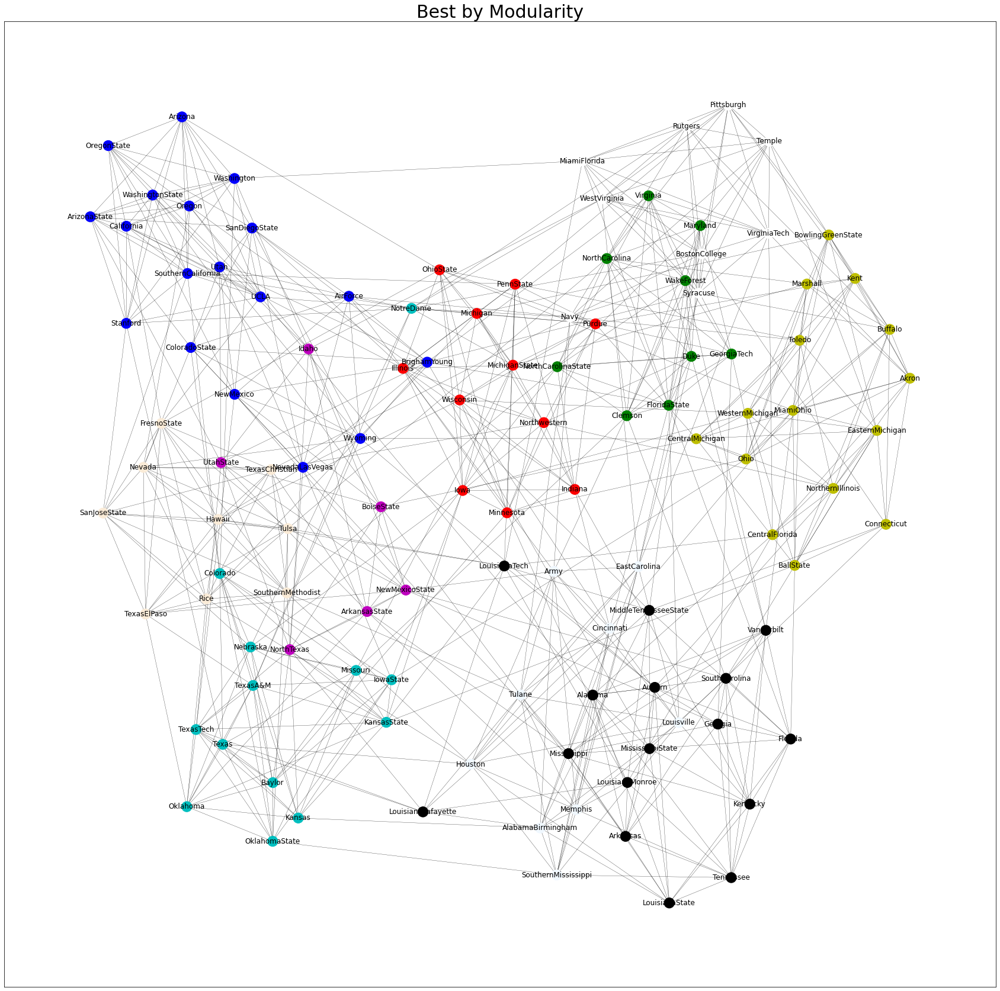

In [296]:
drawCommunities(graph, best_mod_partits_gn[name], 'Best by Modularity')

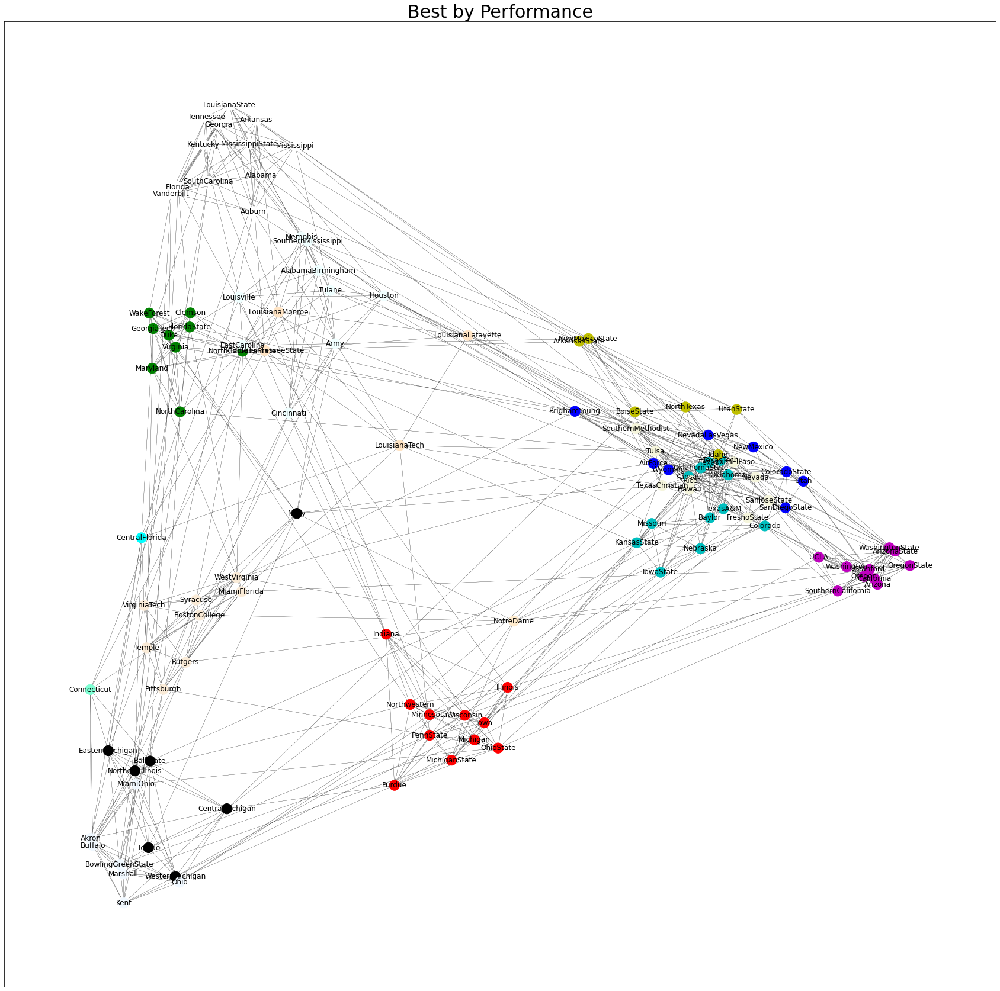

In [312]:
drawCommunities(graph, best_perf_partits_gn[name], 'Best by Performance', layout_func=nx.spectral_layout)

_Spectral Clustering:_

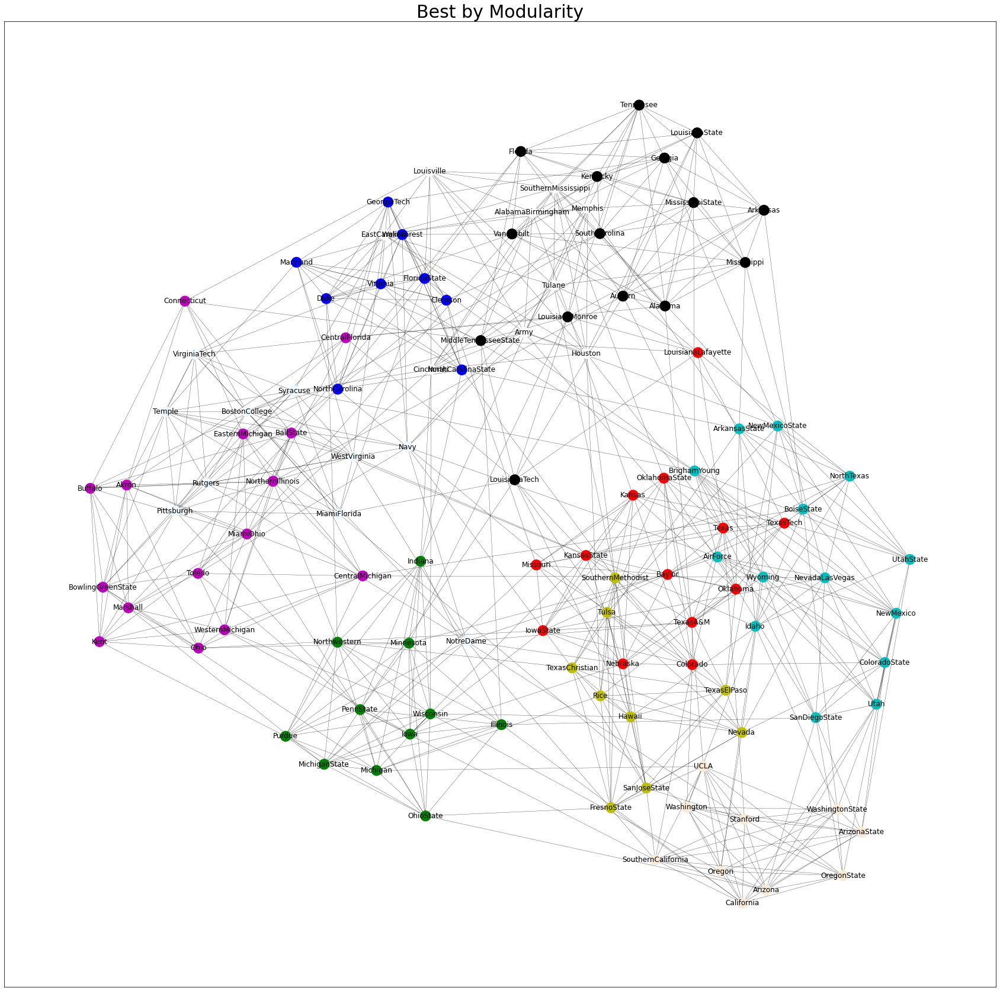

In [313]:
drawCommunities(graph, best_mod_partits_spectral[name], 'Best by Modularity')

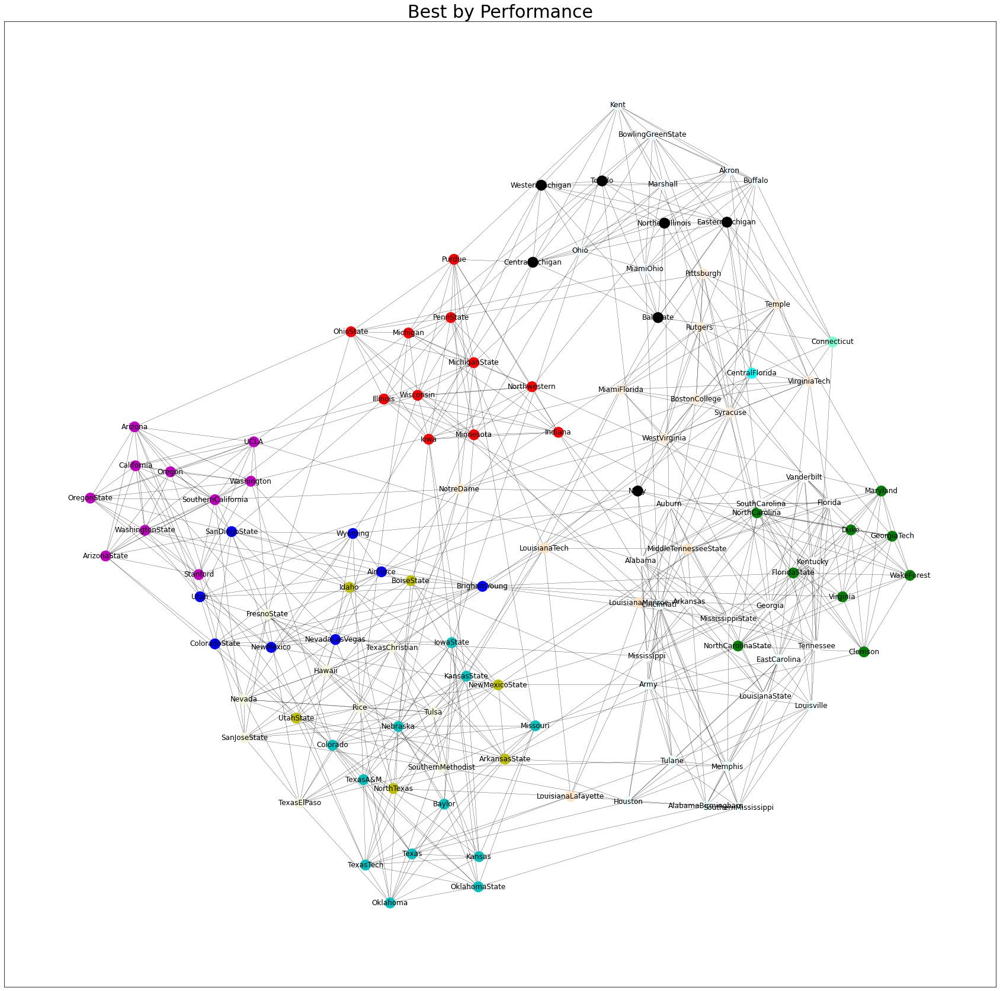

In [314]:
drawCommunities(graph, best_perf_partits_gn[name], 'Best by Performance')

Maximum Modularity Clustering:

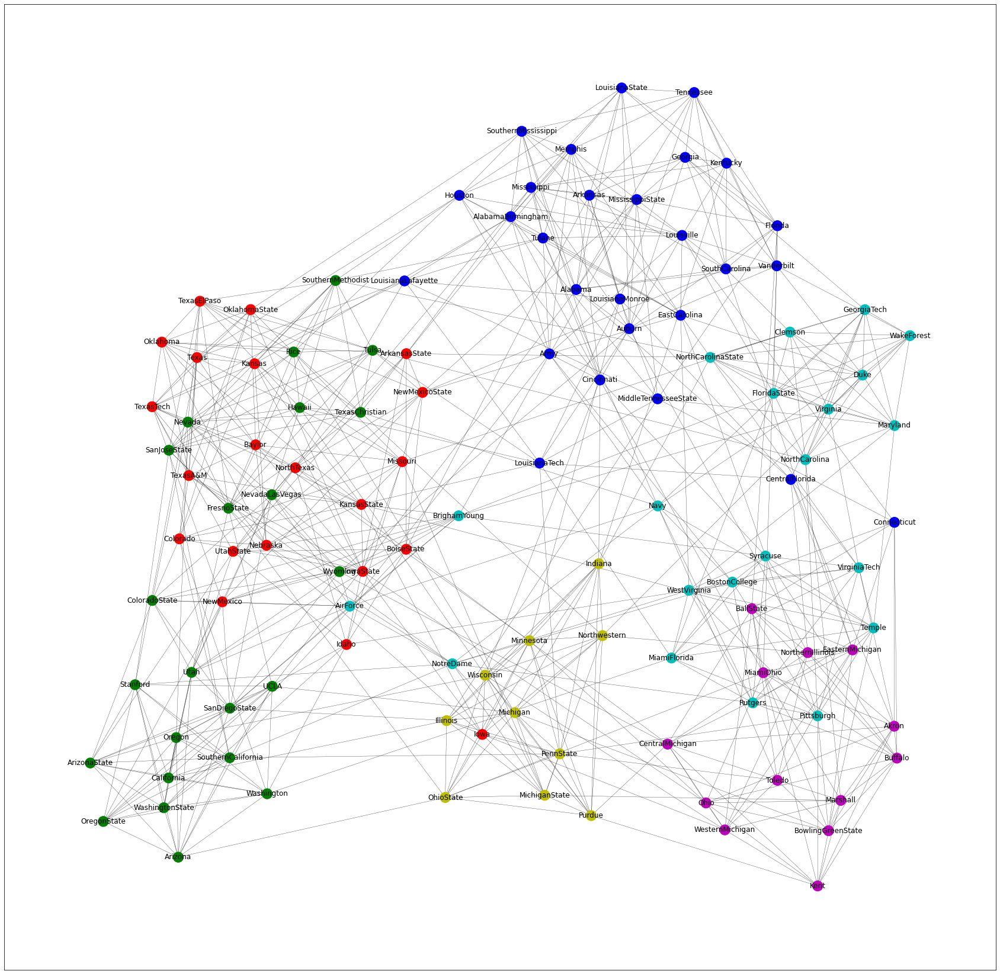

In [322]:
drawCommunities(graph, best_mod_partits_modMax[name], '', layout_func=nx.spring_layout)

Πίνακας Αποτελεσμάτων:

In [451]:
# resultsAsMarkdownTable('football')


| Algorithm | Best Modularity | Size of Partition with best modularity | Best Performance | Size of Partition with best Performance | Calculation Time (s) |
| :-: | :-: | :-: | :-: | :-: | :-: |
|**Girvan-Newman**|0.59963|10|0.9582|17|7.864|
|**Spectral Clustering**|0.6032|10|0.94645|12|3.503|
|**Modularity Maximization**|0.54974|6|0.86819|6|0.078|



Για τον American College Football γράφο παρατηρούμε ότι οι μέθοδοι Girvan-Newman και Spectral-Clustering δίνουν πολύ κοντινά αποτελέσματα και για τις δύο μετρικές. Πάντως, το καλύτερο αποτέλεσμα για το Modularity δίνεται από τον Spectral-Clustering. Για το Performance, δίνεται από τον Girvan-Newman, o οποίος το πετυχαίνει με 17 κοινότητες, έναντι 12 για το SC. O Modularity Maximization απέχει αρκετά σε επίδοση και στις δύο μετρικές, όμως δίνει αποτέλεσμα σε λιγότερο χρόνο (κατά δύο τάξεις μεγέθους), ενώ υπολογίζει και λιγότερες κοινότητες σε σχέση με τους άλλους αλγορίθμους.

#### Οπτικοποίηση κοινοτήτων Game of Thrones

In [323]:
graph, name = got, 'got'

_Girvan-Newman Clustering:_

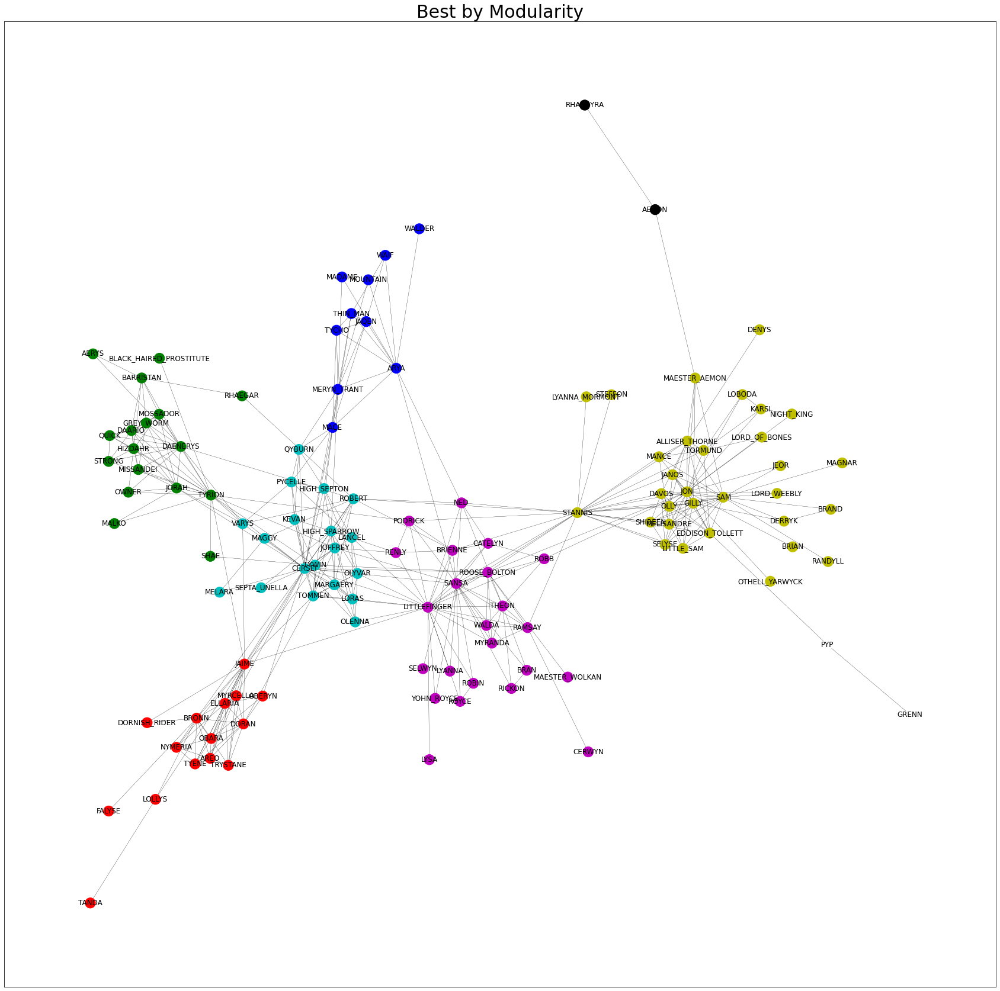

In [324]:
drawCommunities(graph, best_mod_partits_gn[name], 'Best by Modularity')

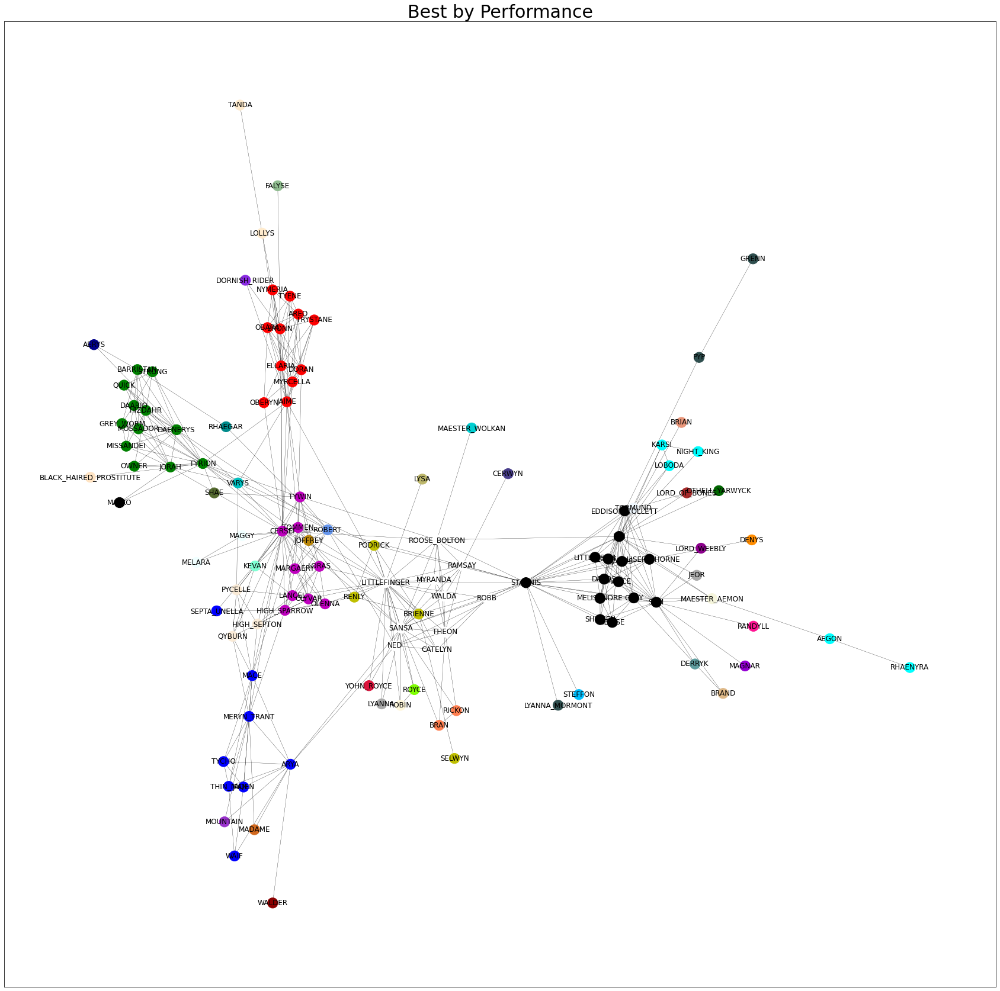

In [332]:
drawCommunities(graph, best_perf_partits_gn[name], 'Best by Performance')

_Spectral Clustering:_

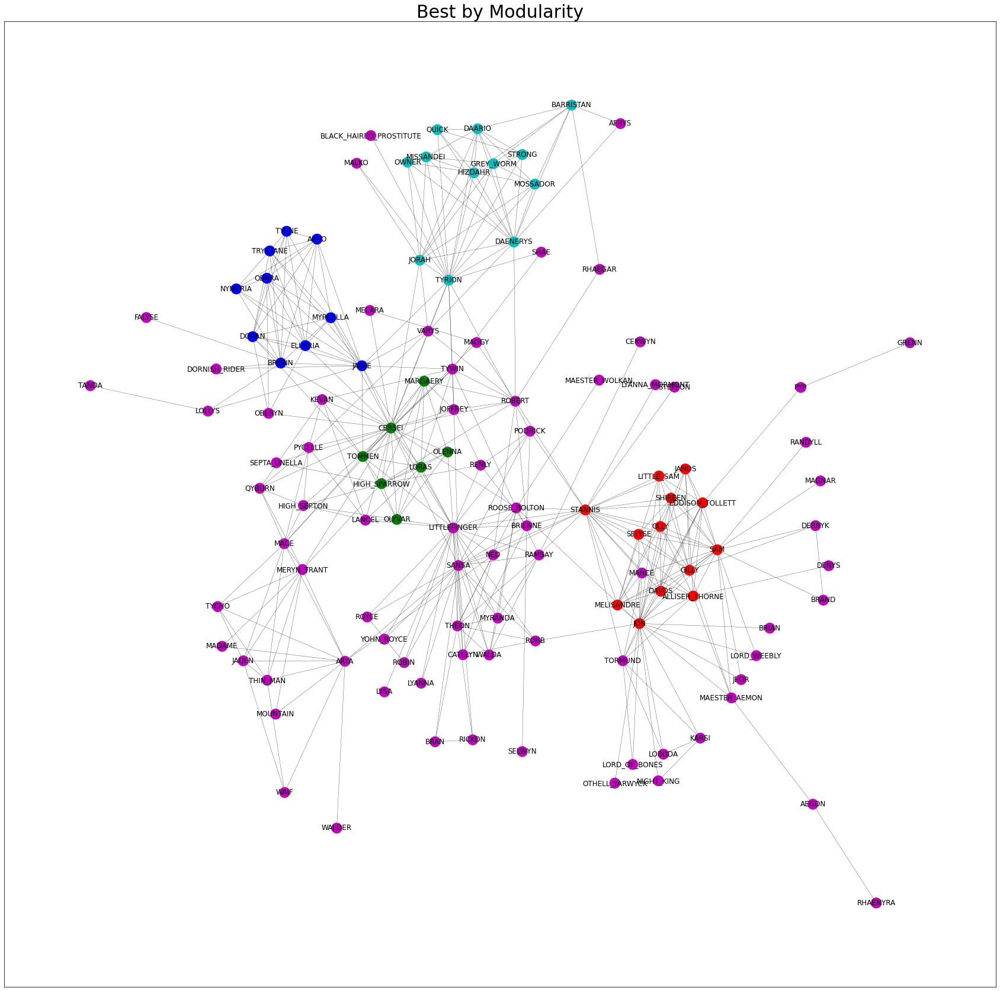

In [336]:
drawCommunities(graph, best_mod_partits_spectral[name], 'Best by Modularity', layout_func=nx.kamada_kawai_layout)

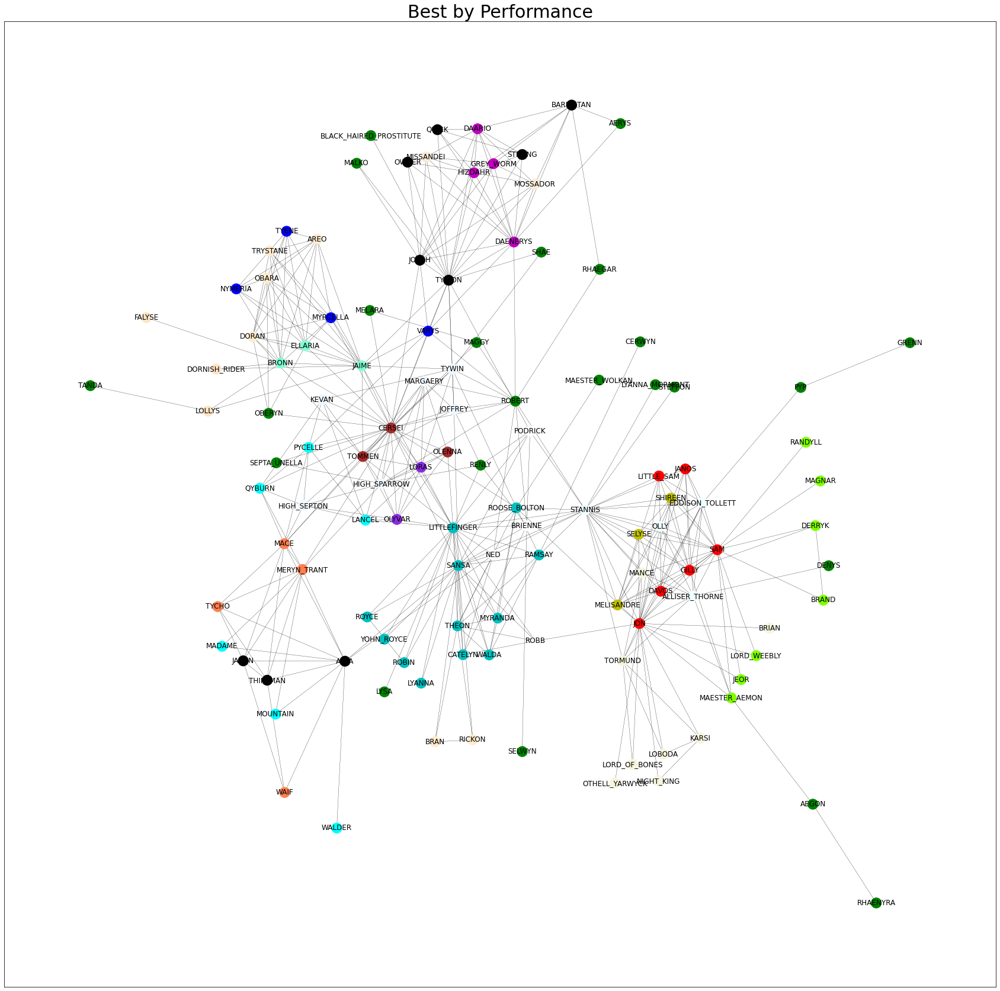

In [352]:
drawCommunities(graph, best_perf_partits_spectral[name], 'Best by Performance', nx.kamada_kawai_layout)

_Maximum Modularity Clustering:_

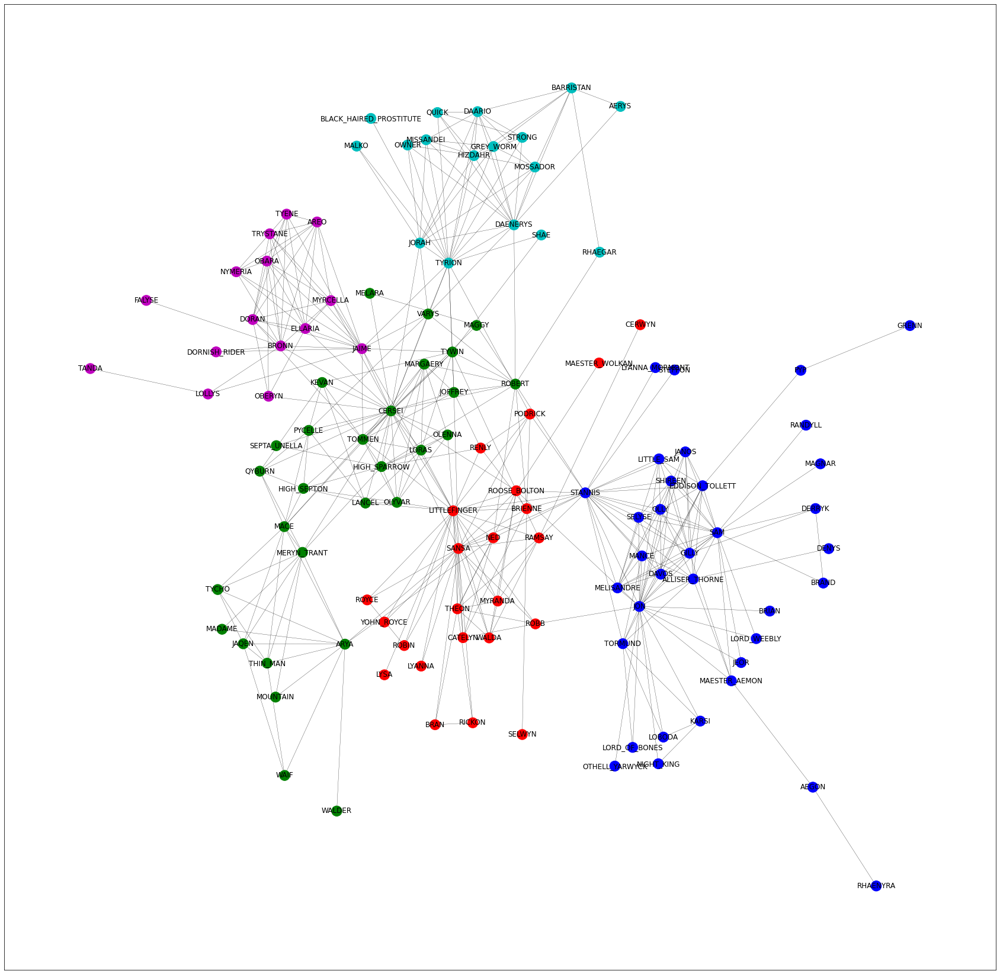

In [354]:
drawCommunities(graph, best_mod_partits_modMax[name], '', nx.kamada_kawai_layout)

Πίνακας αποτελεσμάτων:

In [458]:
# resultsAsMarkdownTable('got')

| Algorithm | Best Modularity | Size of Partition with best modularity | Best Performance | Size of Partition with best Performance | Calculation Time (s) |
| :-: | :-: | :-: | :-: | :-: | :-: |
|**Girvan-Newman**|0.66812|8|0.96425|50|2.78|
|**Spectral Clustering**|0.43759|5|0.90429|29|3.64|
|**Modularity Maximization**|0.66048|5|0.8298|5|0.074|

Στον Game of Thrones γράφο, η μέθοδος Girvan-Newman δίνει το καλύτερο αποτέλεσμα και για τις δύο μετρικές. Στο Performance, μάλιστα πετυχαίνει αισθητά καύτερο αποτέλεσμα από τις άλλες μεθόδους, αλλά βρίσκοντας σημαντικά περισσότερες κοινότητες, 50 έναντι 29 και 5 για τις μεθόδους SC και ΜΜ αντίστοιχα. Σχετικά με το Modularity αξίζει να παρατηρήσουμε ότι η μέθοδος MM πετυχαίνει αποτέλεσμα πολύ κοντά σε αυτό της GN, ενώ τρέχει δύο τάξεις μεγέθους ταχύτερα από την GN.

#### Οπτικοποίηση κοινοτήτων email-Eu-core (να οπτικοποιηθεί και η ground-truth διαμέριση)

In [355]:
name, graph = 'eu', largest_con_subgraph_eu

_Girvan-Newman Clustering:_

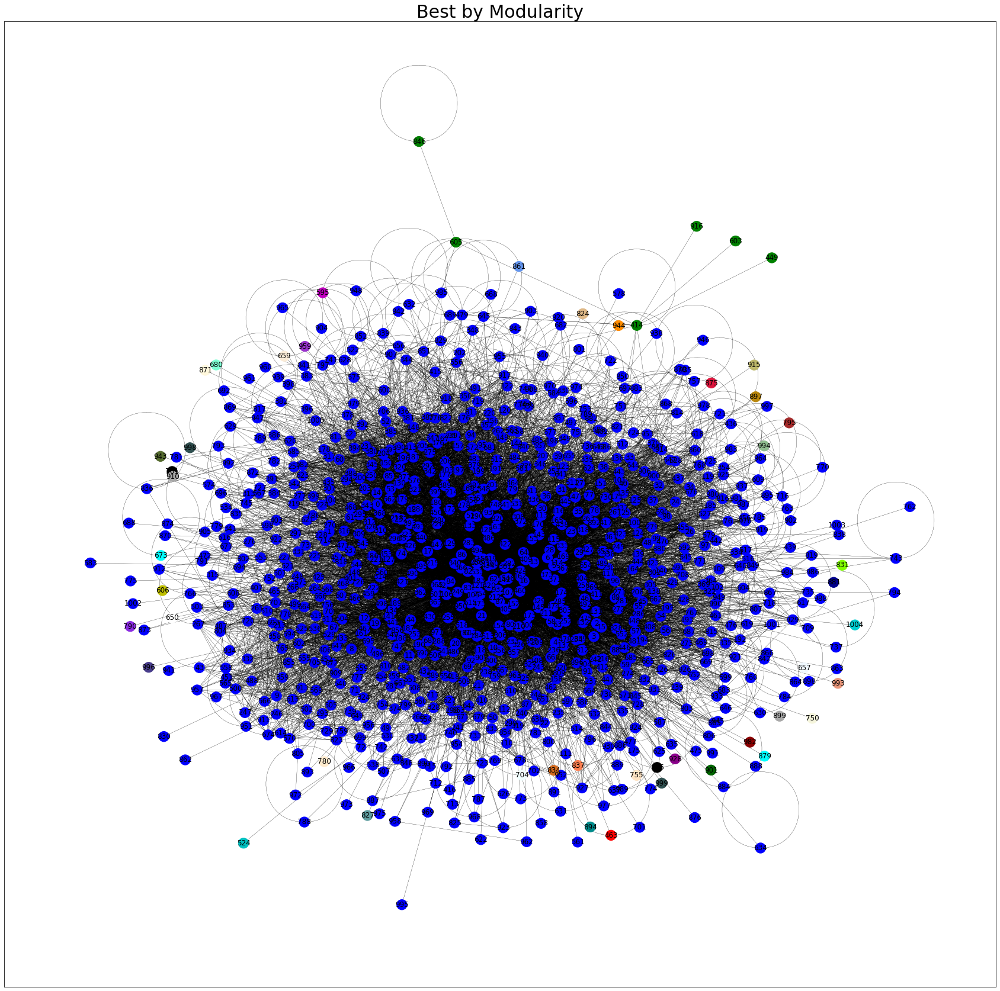

In [357]:
drawCommunities(graph, best_mod_partits_gn[name], 'Best by Modularity', nx.kamada_kawai_layout)

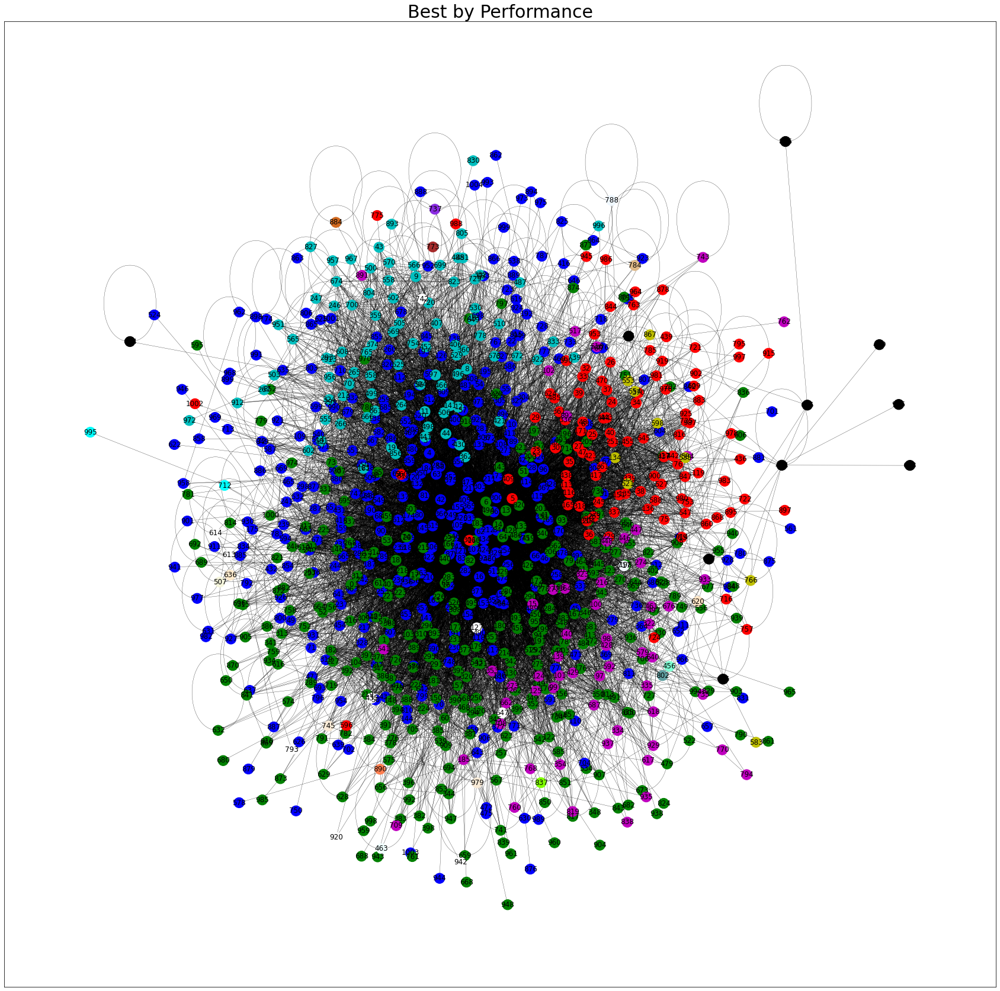

In [360]:
drawCommunities(graph, best_perf_partits_modMax[name], 'Best by Performance', layout_func=nx.nx_pydot.pydot_layout)

_Spectral Clustering:_

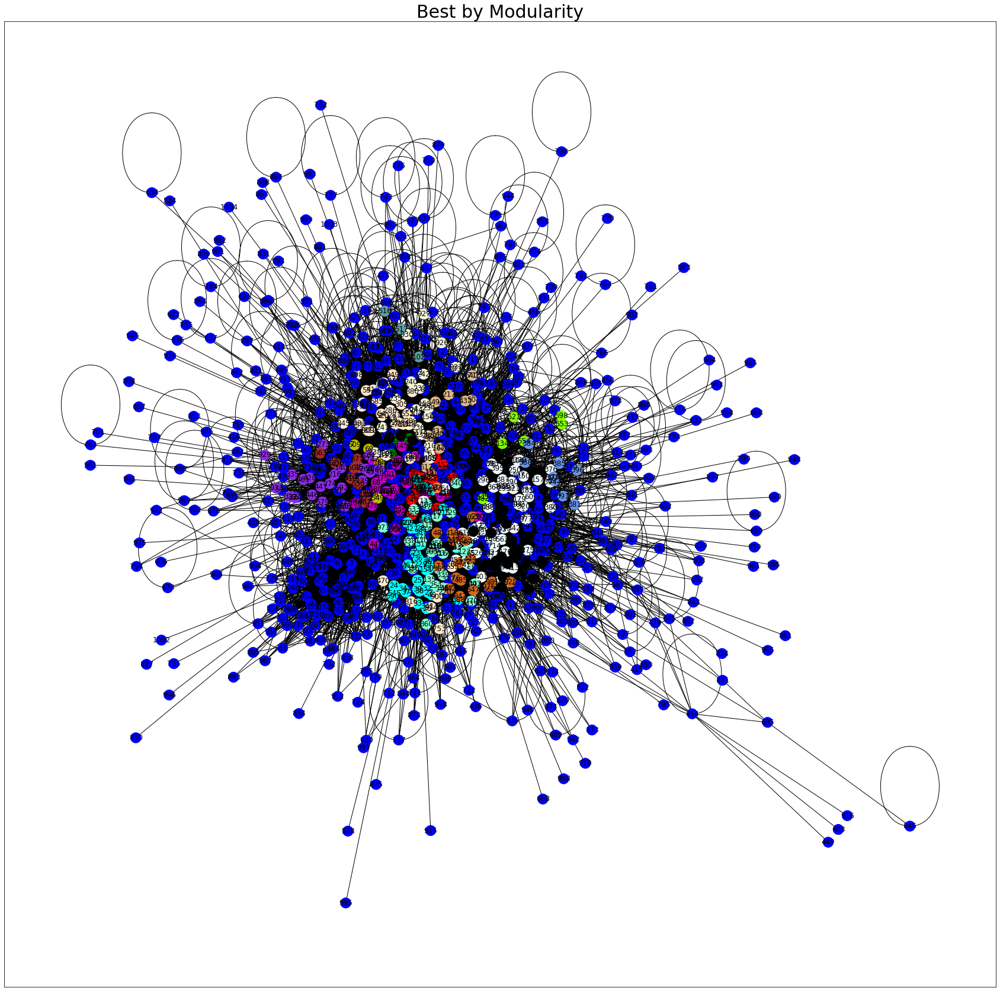

In [124]:
drawCommunities(graph, best_mod_partits_spectral[name], 'Best by Modularity')

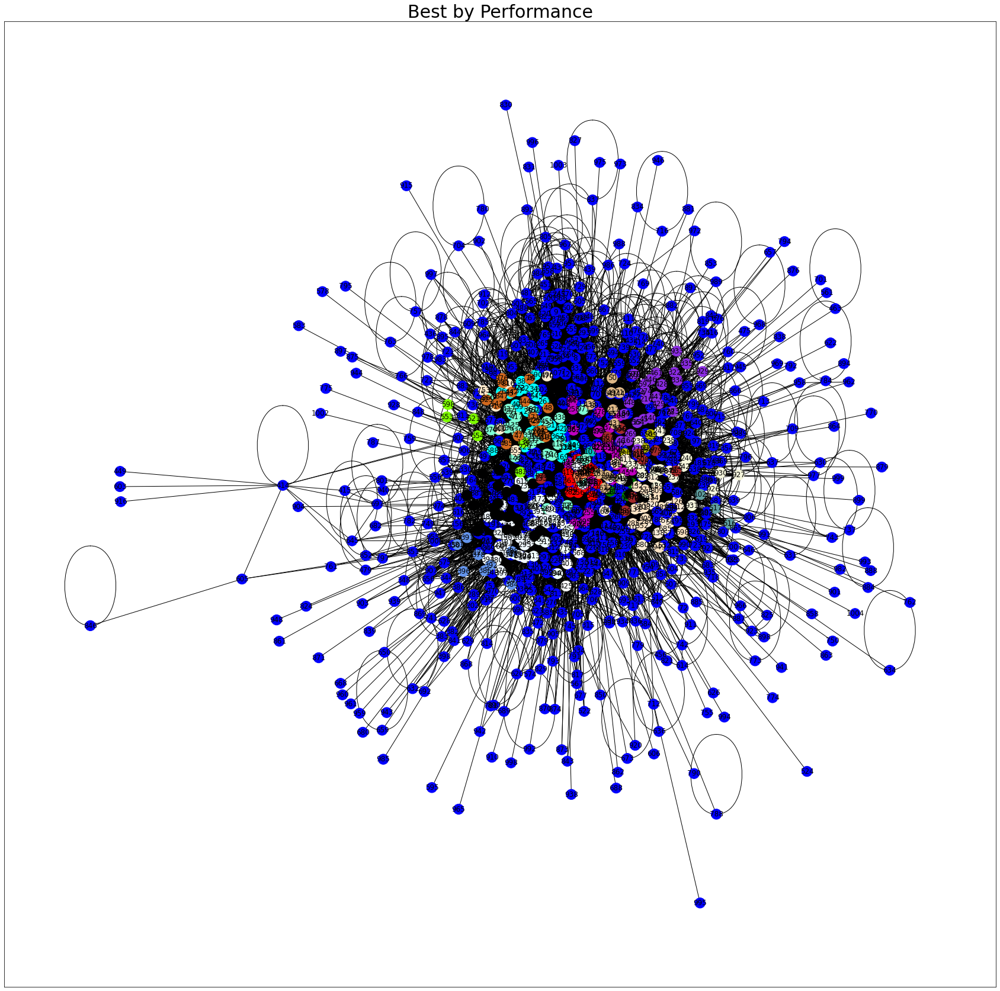

In [125]:
drawCommunities(graph, best_mod_partits_spectral[name], 'Best by Performance')

_Maximum Modularity Clustering:_

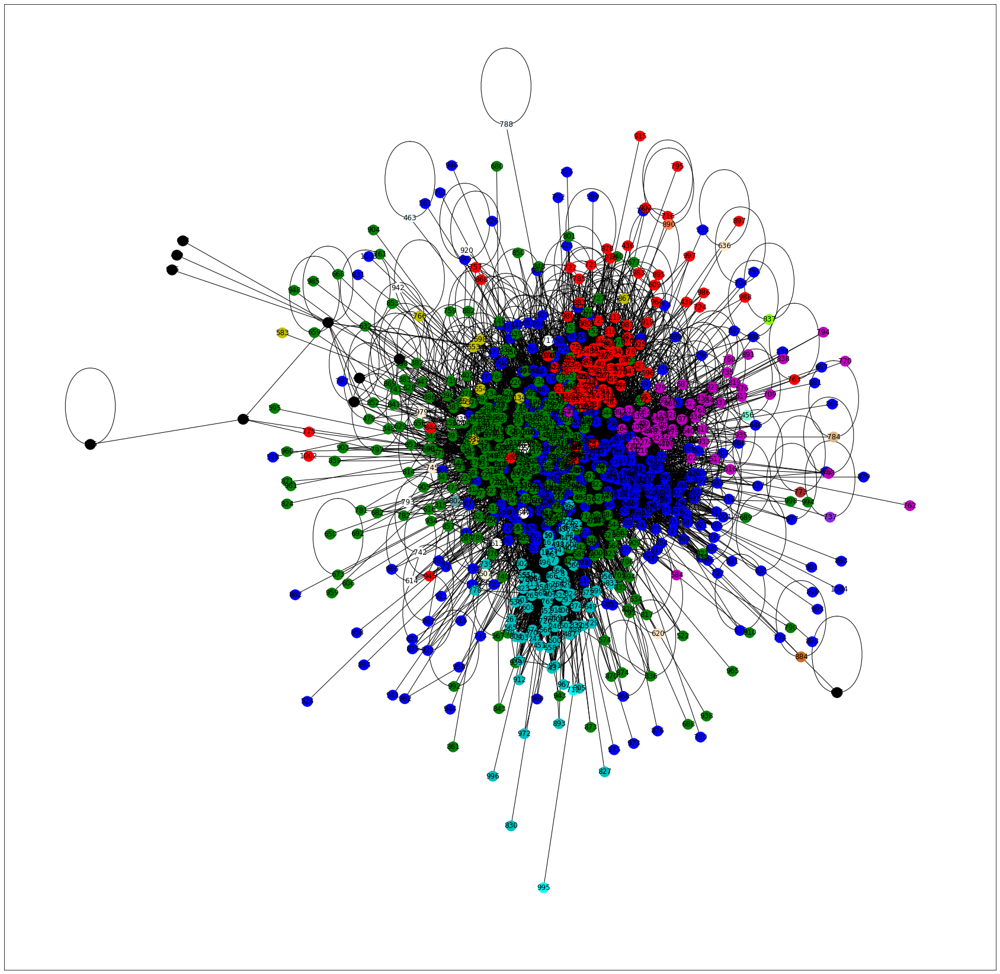

In [126]:
drawCommunities(graph, best_mod_partits_modMax[name], '')

Πίνακας Αποτελεσμάτων:

In [477]:
# resultsAsMarkdownTable('eu')
# print()
# disp = """
# | Algorithm | Modularity | Performance | Size of Partition | 
# | :-: | :-: | :-: | :-: |
# """
# disp += "|**"+'ground-truth'+"**|"+str(round(best_mod_gt,5))+"|" \
#     +str(round(best_perf_gt,5))+"|" + str(len(best_mod_partit_gt)) +"|\n"
# print(disp)


| Algorithm | Best Modularity | Size of Partition with best modularity | Best Performance | Size of Partition with best Performance | Calculation Time (s) |
| :-: | :-: | :-: | :-: | :-: | :-: |
|**Girvan-Newman**|0.00155|47|0.14069|50|680.26|
|**Spectral Clustering**|0.18873|26|0.7546|50|779.542|
|**Modularity Maximization**|0.3655|25|0.74554|25|4.314|



| Algorithm | Modularity | Performance | Size of Partition | 
| :-: | :-: | :-: | :-: |
|**ground-truth**|0.32339|0.32575|2|



Ξεκινώντας από το Modularity, για τον EU γράφο το καλύτερο αποτέλεσμα δίνεται από τον αλγόρθμο Modularity Maximization που απαιτεί 4 δευτερόλεπτα. Έχει ενδιαφέρον ότι οι μέθοδοι GN και SC που χρειάζονται 11 και 13 λεπτά αντίστοιχα δίνουν εδώ σημαντικά χειρότερα αποτελέσματα. Ως προς το Performance, υπερισχύει η SC, αλλά με μικρή διαφορά από την ασύγκριτα ταχύτερη MM. Αξίζει επίσης να παρατηρήσουμε ότι η SC πετυχαίνει το αποτέλεσμά της υπολογίζοντας 50 κοινότητες, ενώ η MM 25. 

Σχετικά με την Ground-Truth Διαμέριση βλέπουμε ότι πετυχαίνει modularity αρκετά κοντά στο βέλτιστο που επιτυγχάνει η MM. Όσον αφορά το Performance, βέβαια απέχει πολύ από τα αποτελέσματα των μεθόδων SC και MM. Είναι ενδιαφέρον, όμως ότι η ground-truth διαμέριση έχει δύο μόνο κοινότητες, ενώ οι υπόλοιποι αλγόριθμοι υπολογίζουν διαμερίσεις με τουλάιχστον 25 κοινότητες. 

#### Οπτικοποίηση κοινοτήτων REG

In [127]:
name, graph = 'REG', REG

_Girvan-Newman Clustering:_

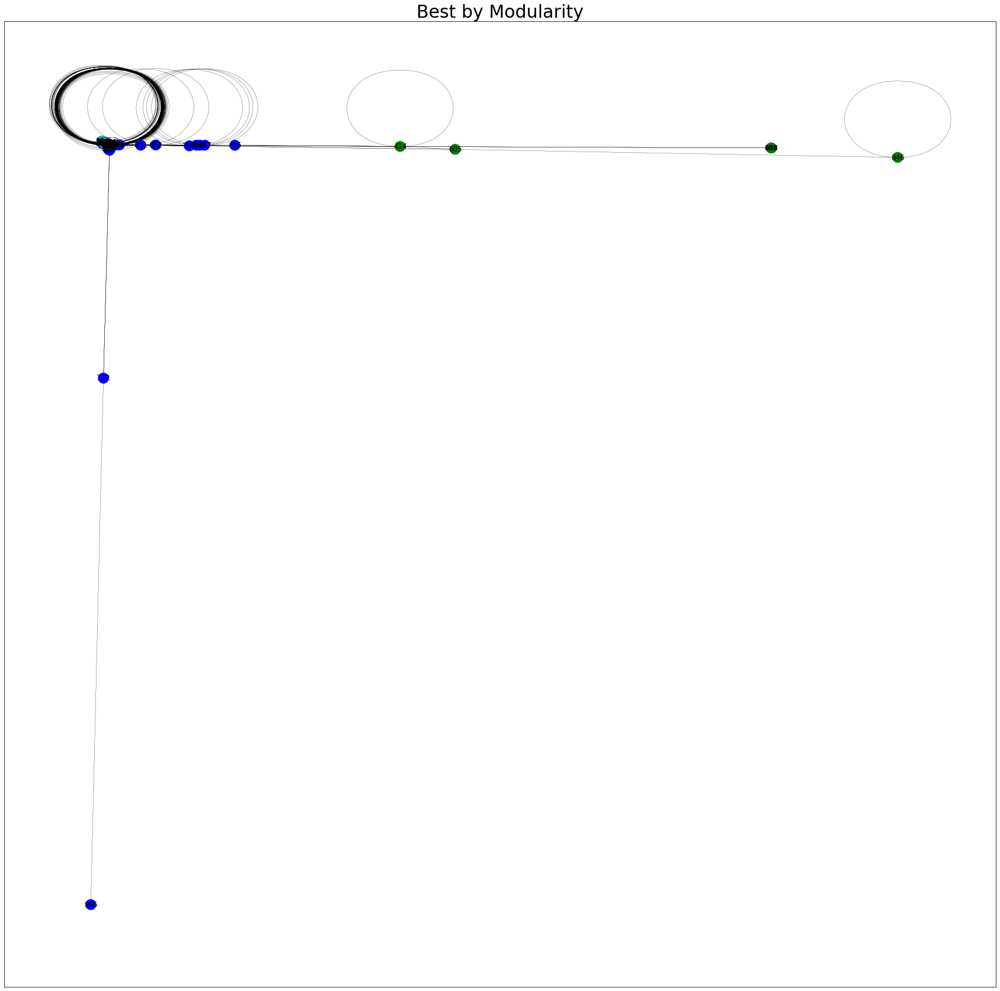

In [361]:
drawCommunities(graph, best_mod_partits_gn[name], 'Best by Modularity', layout_func=nx.spectral_layout)

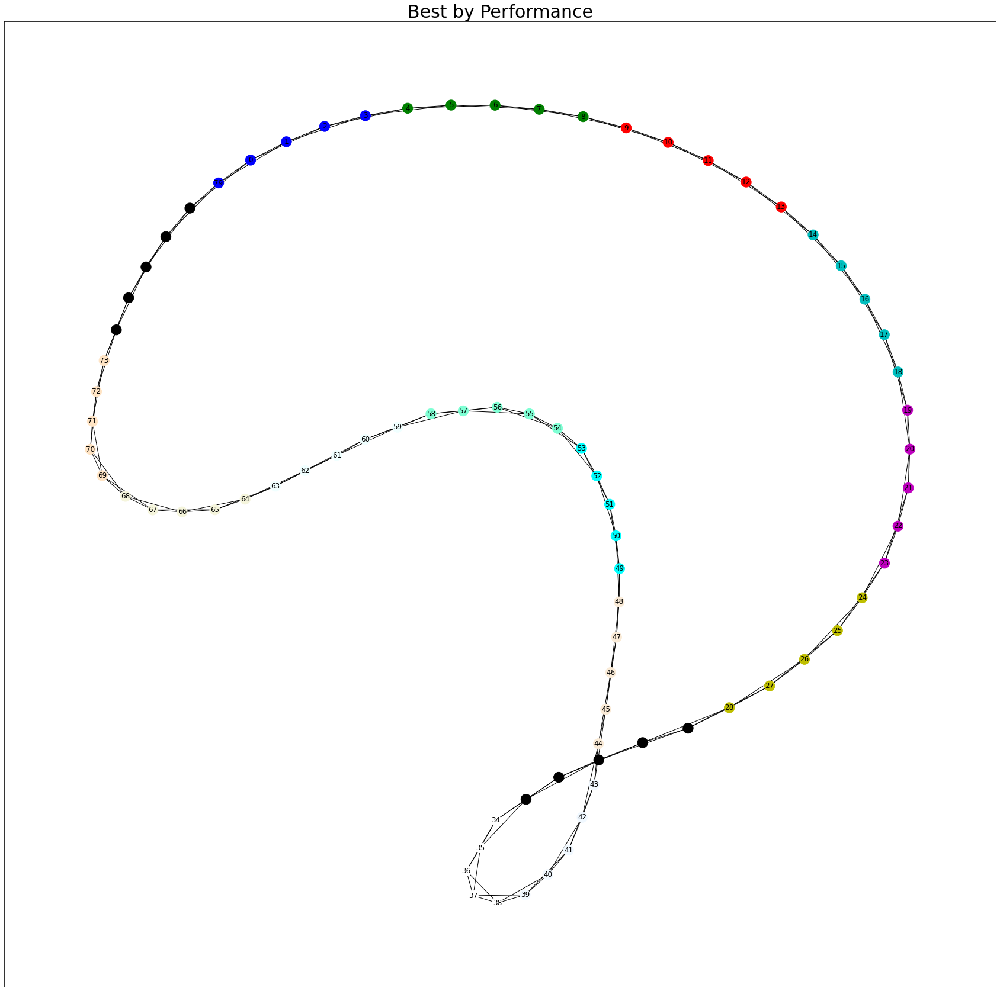

In [129]:
drawCommunities(graph, best_perf_partits_gn[name], 'Best by Performance')

_Spectral Clustering:_

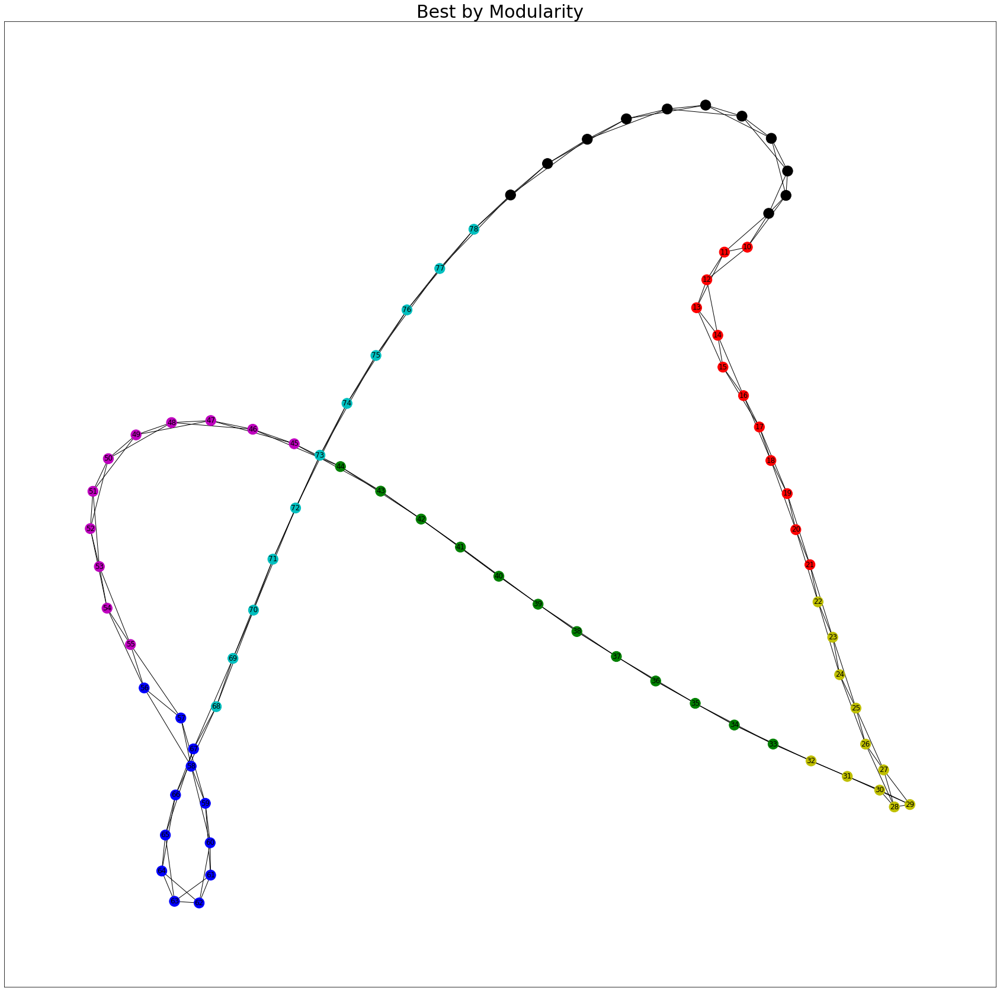

In [130]:
drawCommunities(graph, best_mod_partits_spectral[name], 'Best by Modularity')

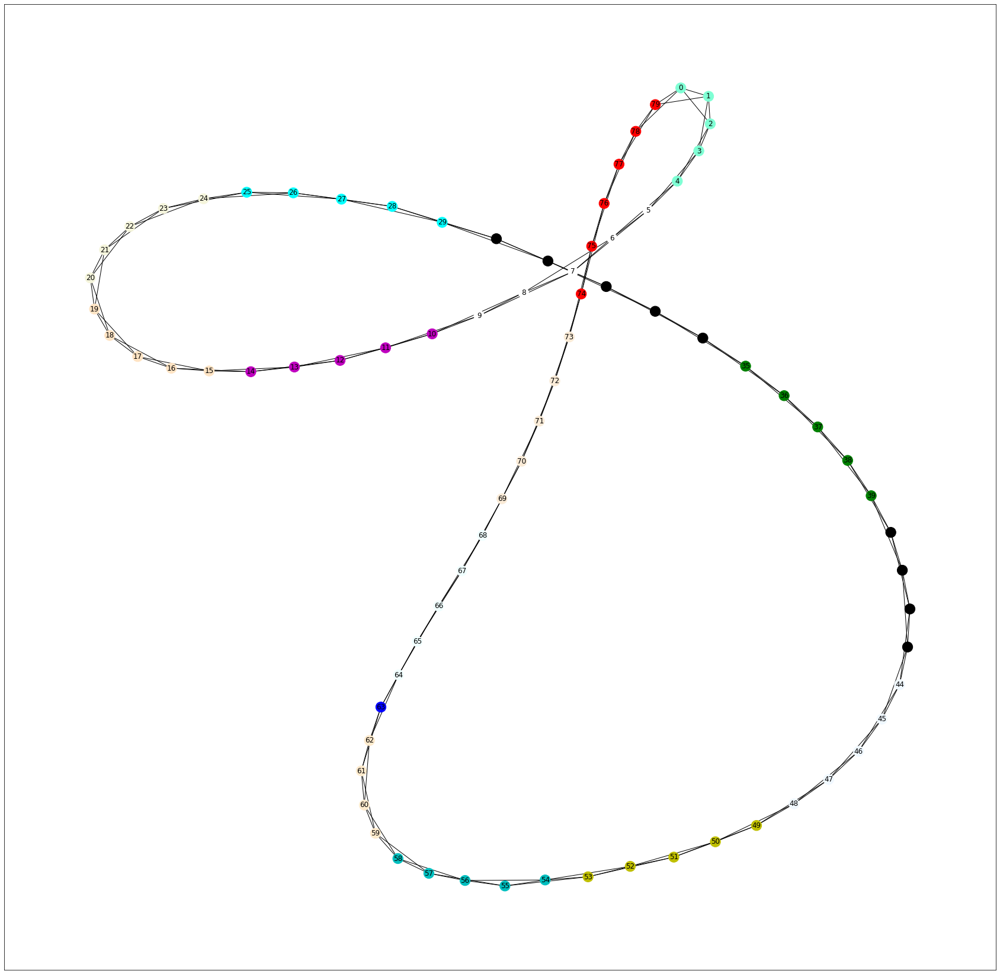

In [131]:
drawCommunities(graph, best_perf_partits_spectral[name], '')

_Maximum Modularity Clustering:_

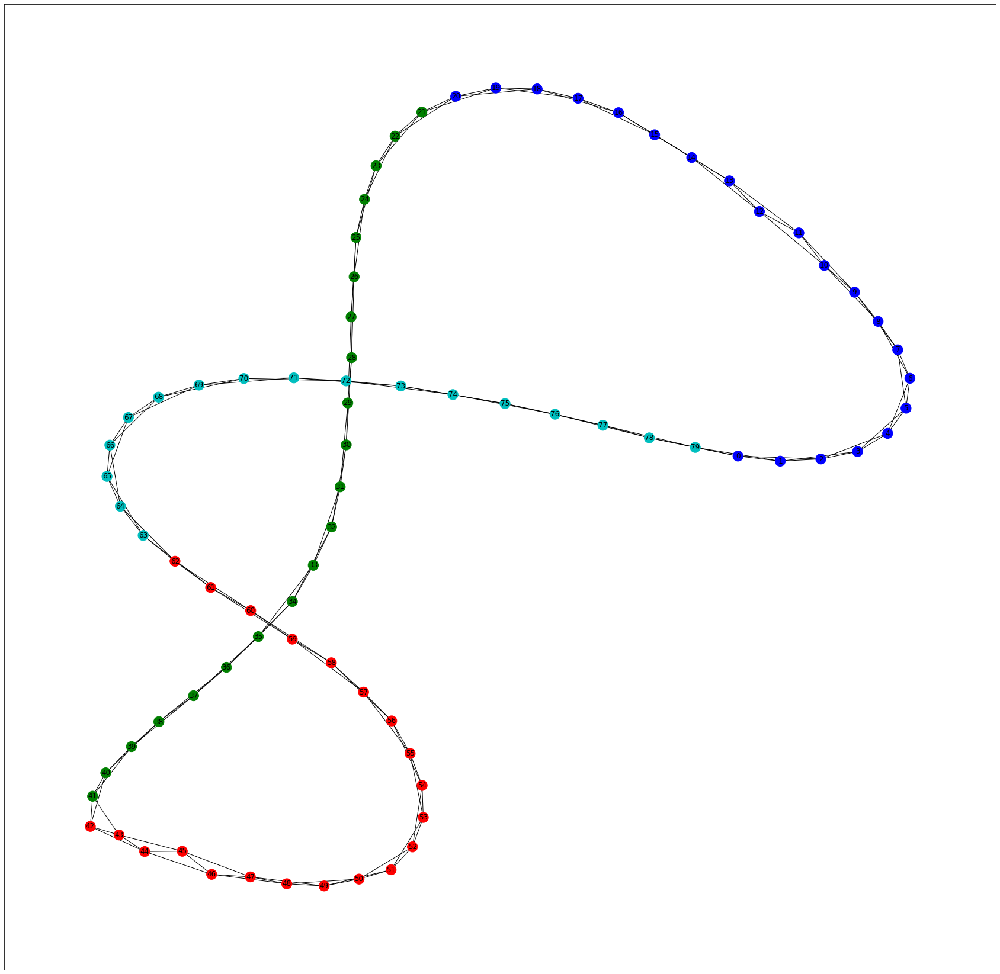

In [132]:
drawCommunities(graph, best_mod_partits_modMax[name], '')

In [463]:
# resultsAsMarkdownTable('REG')

| Algorithm | Best Modularity | Size of Partition with best modularity | Best Performance | Size of Partition with best Performance | Calculation Time (s) |
| :-: | :-: | :-: | :-: | :-: | :-: |
|**Girvan-Newman**|0.725|8|0.96962|16|0.51|
|**Spectral Clustering**|0.72563|7|0.9693|18|0.816|
|**Modularity Maximization**|0.67312|4|0.80063|4|0.015|

Για τον REG, ο GN και ο SC δίνουν πολυ κοντινά αποτελέσματα και για τις δύο μετρικές (η διαφορά βρίσκεται και στις δύο περιπτώσεις στο 4ο δεκαδικό ψηφίο). Άλλωστε, υπολογίζουν και κοντικό αριθμό κοινοτήτων. Ο MM έχει αρκετά χειρότερα αποτελέσματα, ενώ υπολογίζει σημαντικά μικρότερες κοινότητες.

#### Οπτικοποίηση κοινοτήτων RGER

In [362]:
name, graph = 'RGER', RGER

_Girvan-Newman Clustering:_

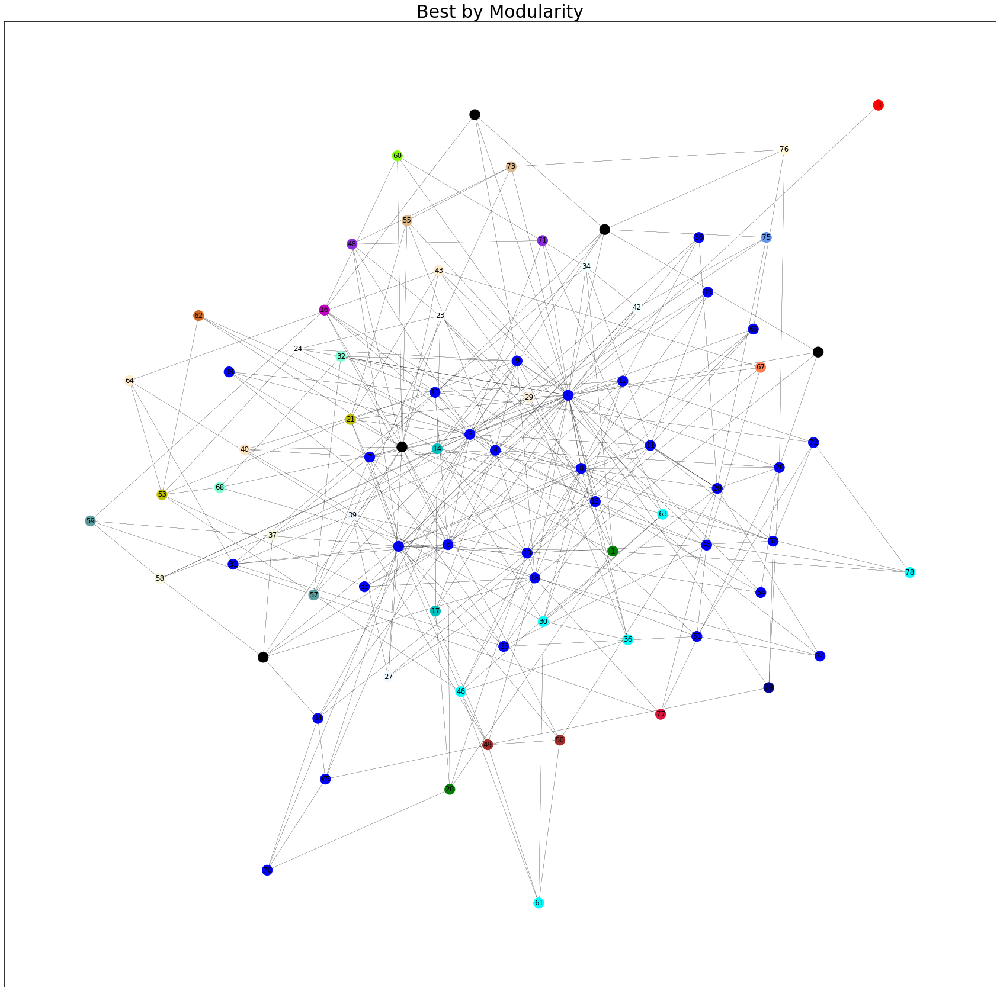

In [482]:
drawCommunities(graph, best_mod_partits_gn[name], 'Best by Modularity', )

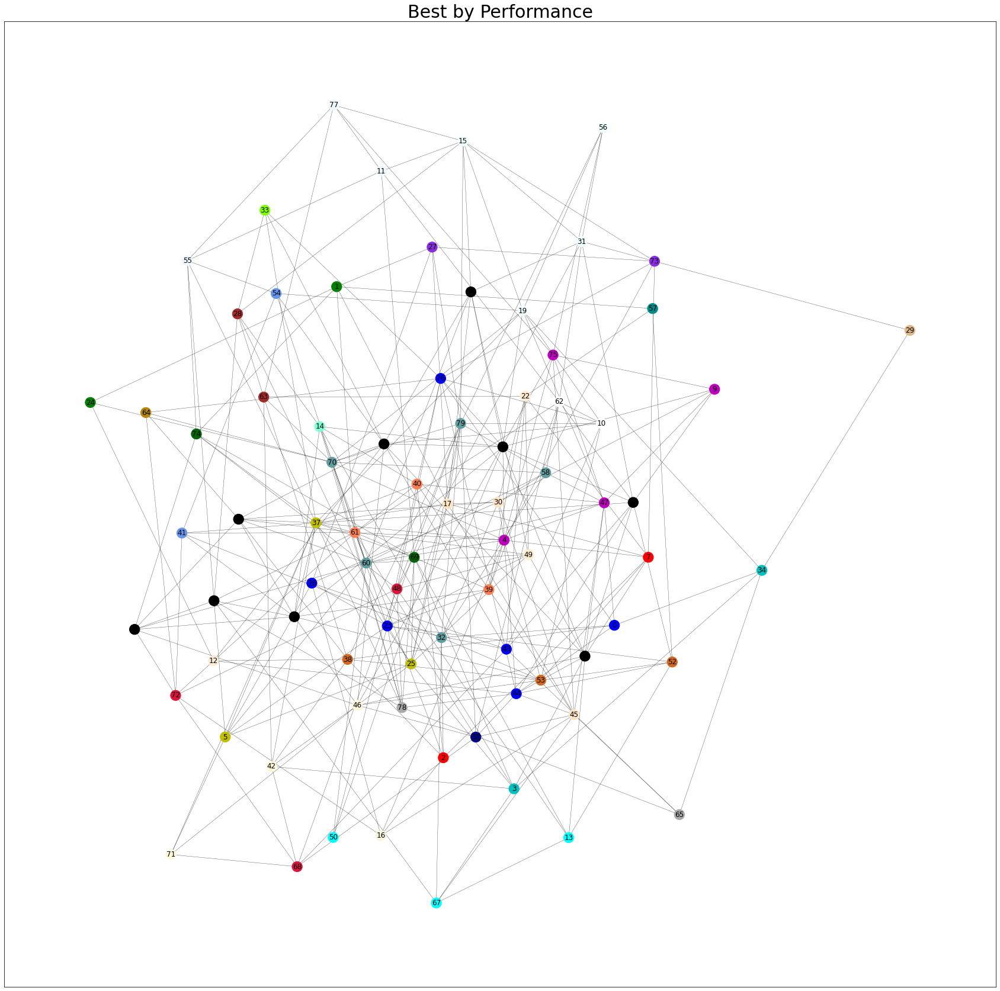

In [368]:
drawCommunities(graph, best_perf_partits_gn[name], 'Best by Performance')

_Spectral Clustering:_

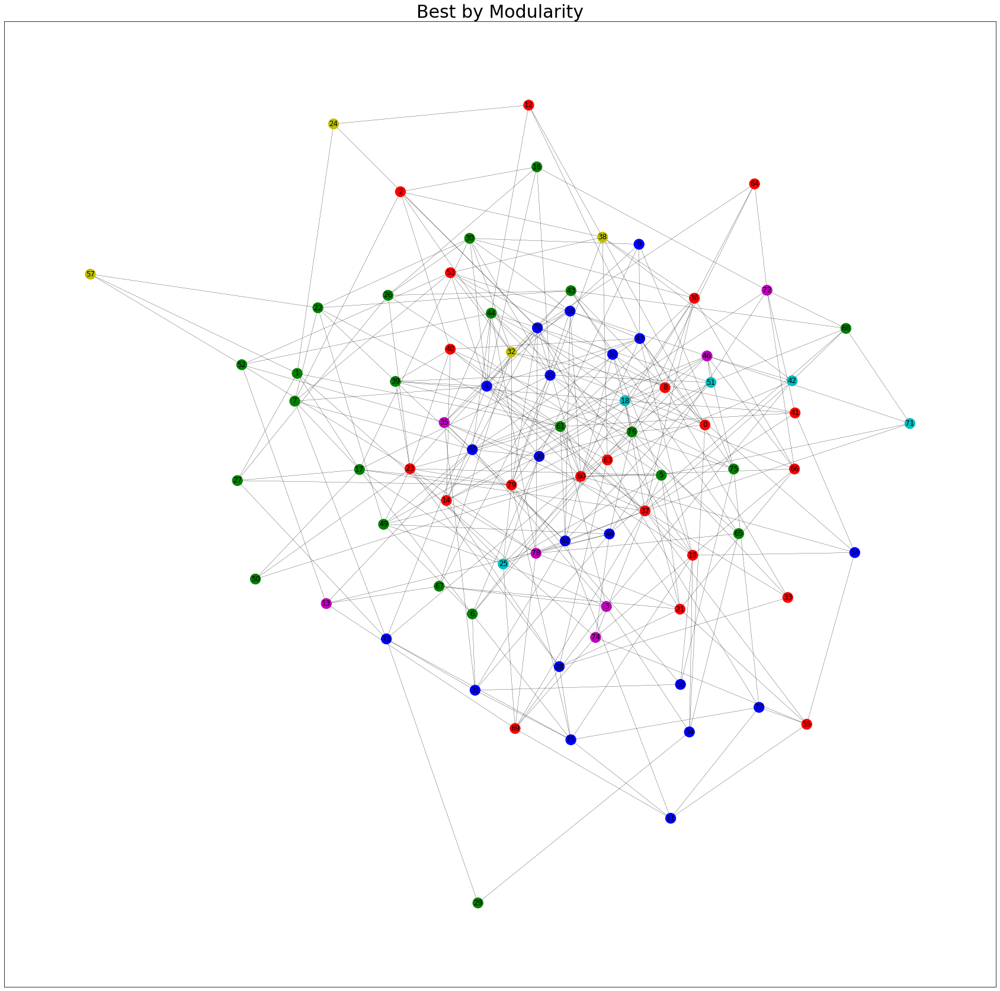

In [369]:
drawCommunities(graph, best_mod_partits_spectral[name], 'Best by Modularity')

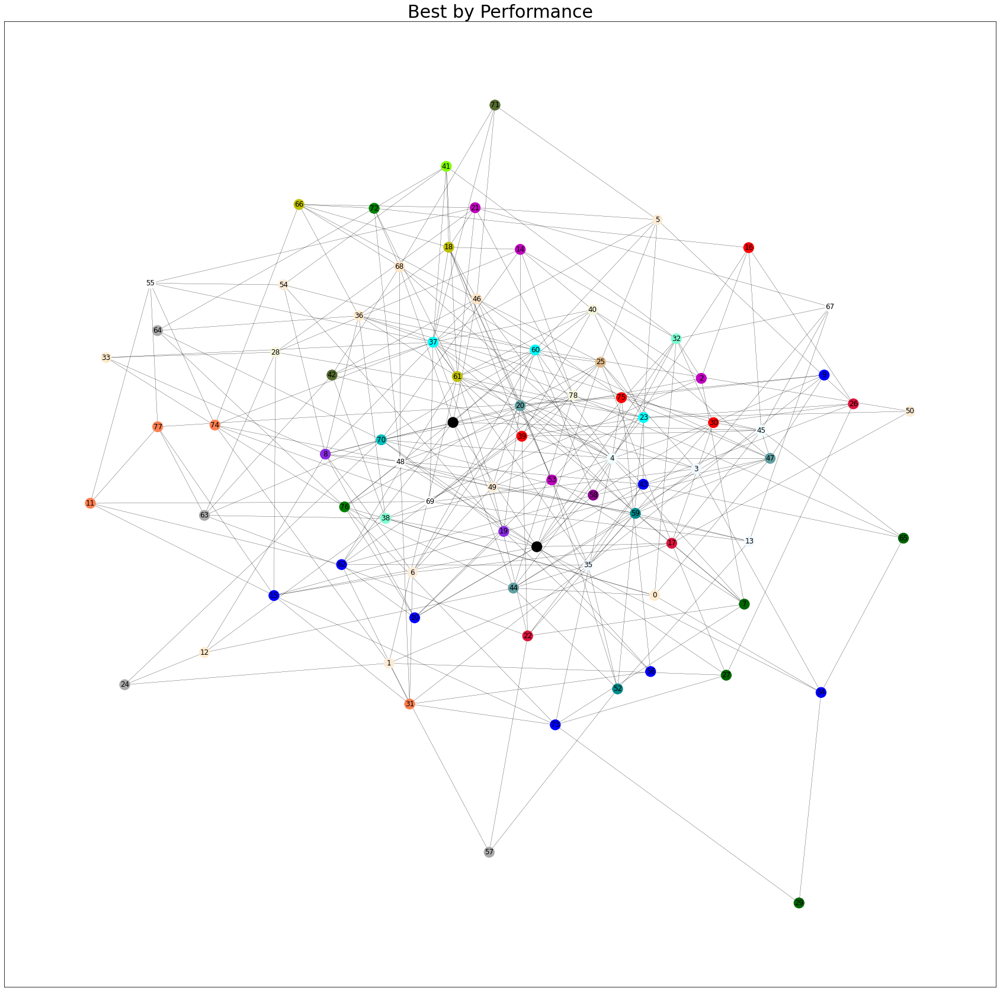

In [370]:
drawCommunities(graph, best_perf_partits_spectral[name], 'Best by Performance')

_Maximum Modularity Clustering:_

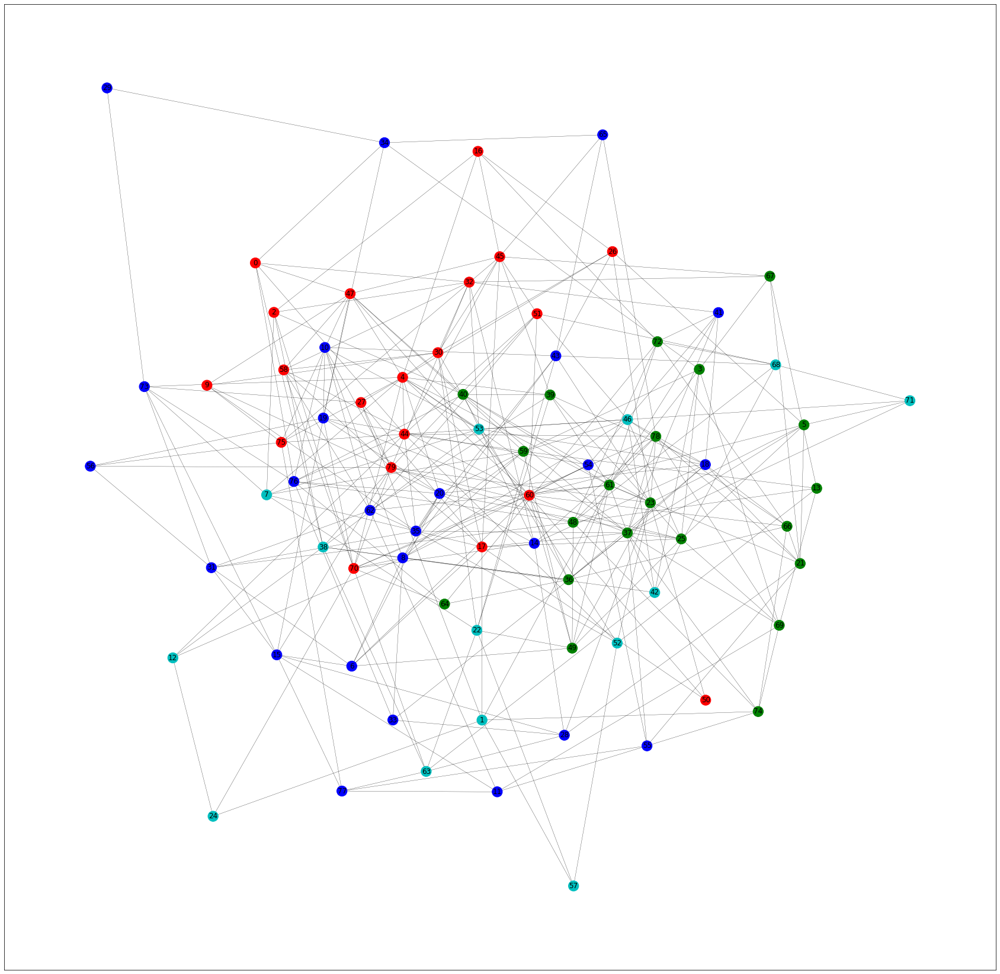

In [371]:
drawCommunities(graph, best_mod_partits_modMax[name], '')

In [466]:
# resultsAsMarkdownTable('RGER')

| Algorithm | Best Modularity | Size of Partition with best modularity | Best Performance | Size of Partition with best Performance | Calculation Time (s) |
| :-: | :-: | :-: | :-: | :-: | :-: |
|**Girvan-Newman**|0.21109|24|0.92152|34|3.191|
|**Spectral Clustering**|-0.00317|6|0.87753|41|0.986|
|**Modularity Maximization**|0.28365|4|0.75918|4|0.033|

Στον RGER, το καλύτερο Modularity επιτυγχάνεται από τον MM. Έχει ενδιαφέρον ότι αυτό αντιστοιχεί σε διαμεριση με 4 κοινότητες, ενώ ο GN, o αμέσως καλύτερος υπολογίζει διαμέριση με 24 κοινότητες. O SC δίνει εδώ την μοναδική αρνητική τιμή Modularity σε όλα μας τα αποτελέσματα. Όσον αφορά το Performance, ο καλύτερος είναι ο GN με αρκετή διαφορά, αν και υπολογίζει αρκετά λιγότερες κοινότητες από τον SC (34 έναντι 41).

Σχετικά με την οπτικοποίηση παρατηρούμε εδώ πιο άναρχα αποτελέσματα σε σχέση με τον REG. Δεν είναι, δηλαδή τόσο διαισθητικός ο χωρισμός σε κοινότητες. Αυτό μπορεί να εξηγηθεί από τον αμιγώς τυχαίο χαρακτήρα του γρλαφου.

#### Οπτικοποίηση κοινοτήτων RGG

In [491]:
name, graph = 'RGG', RGG

_Girvan-Newman Clustering:_

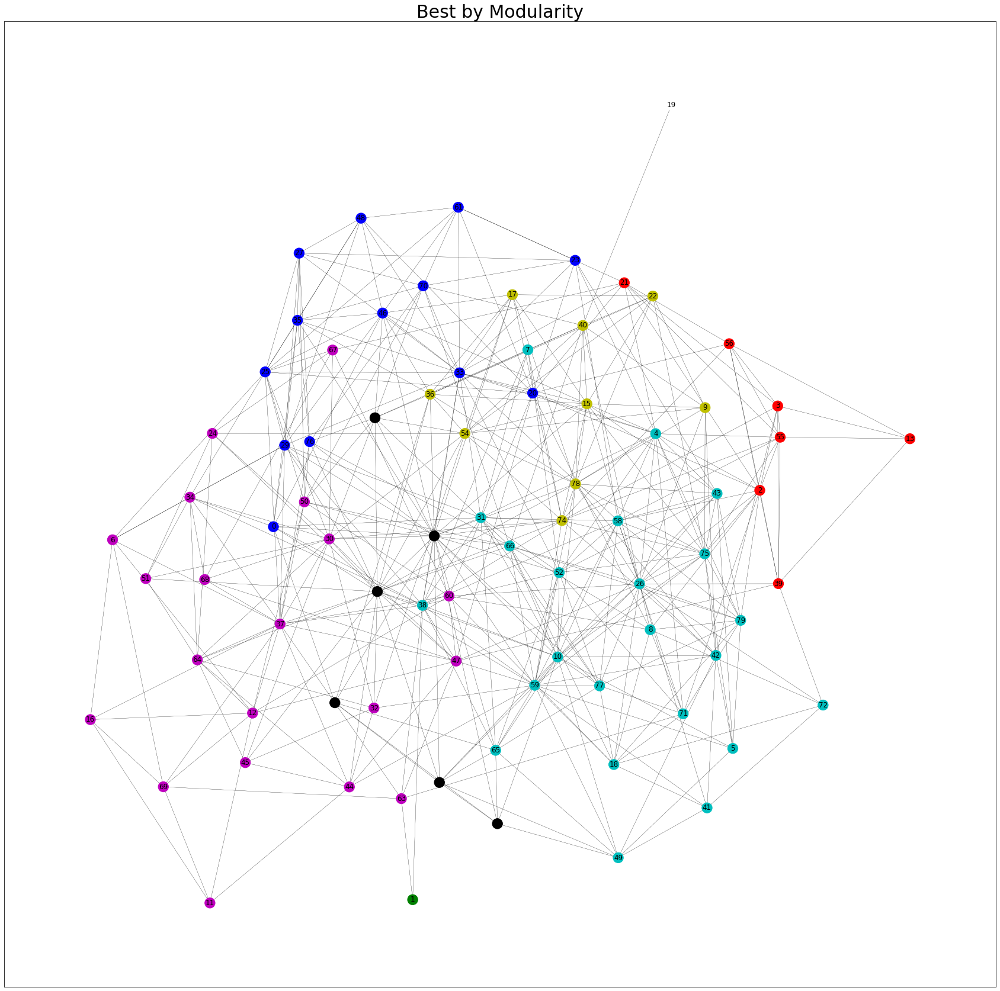

In [500]:
drawCommunities(graph, best_mod_partits_gn[name], 'Best by Modularity', layout_func=nx.kamada_kawai_layout)

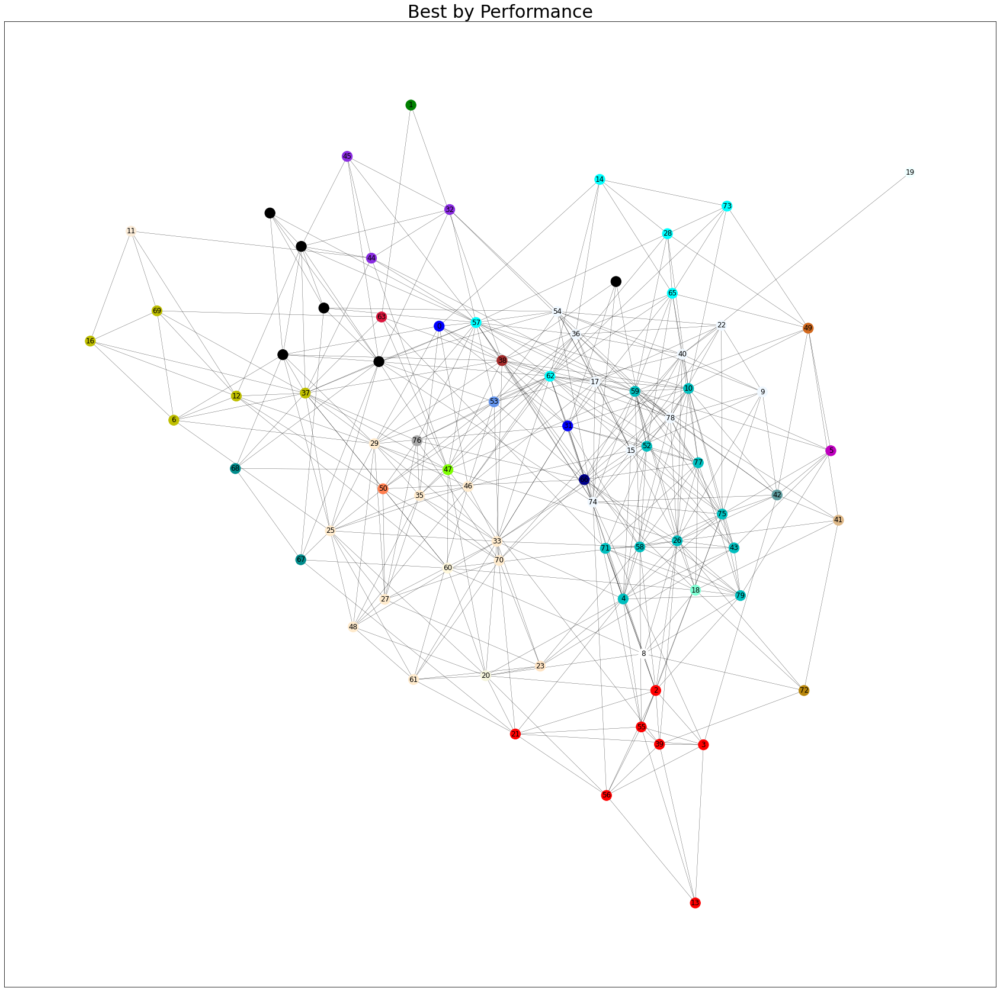

In [511]:
drawCommunities(graph, best_perf_partits_gn[name], 'Best by Performance')

_Spectral Clustering:_

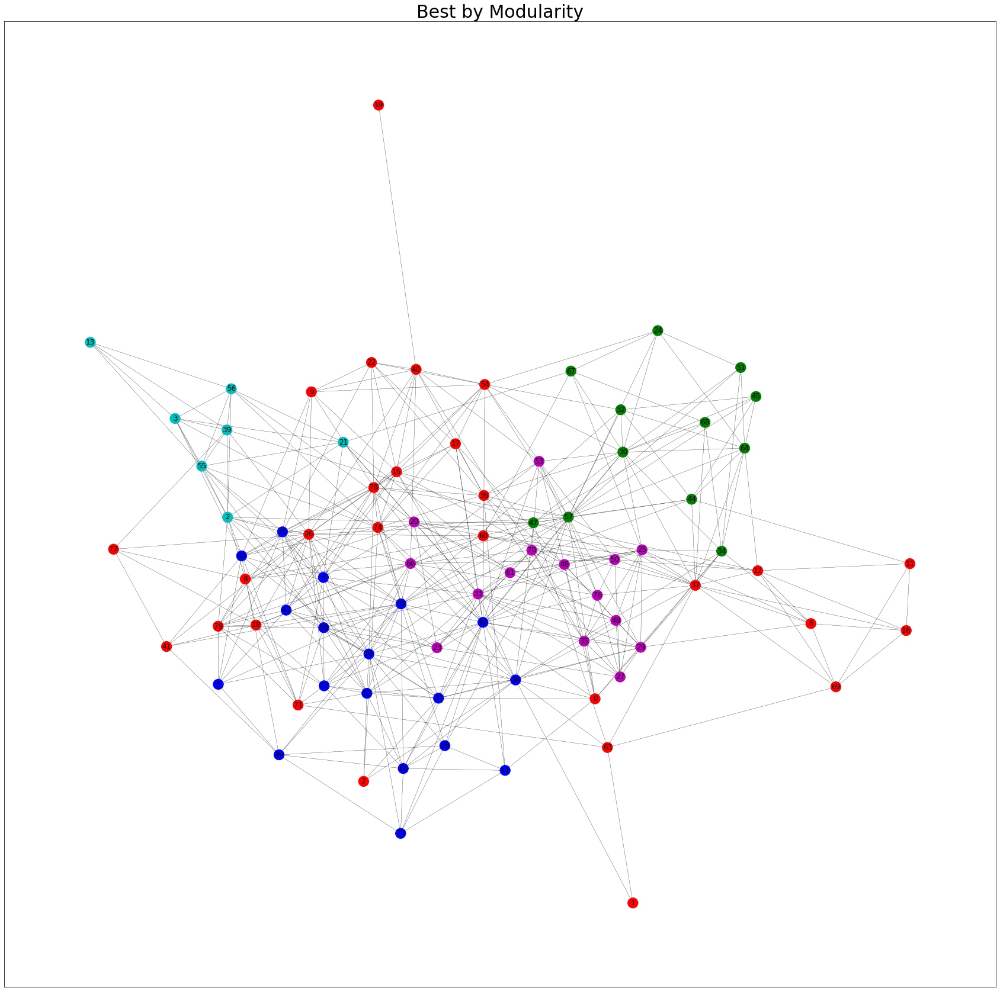

In [514]:
drawCommunities(graph, best_mod_partits_spectral[name], 'Best by Modularity', )

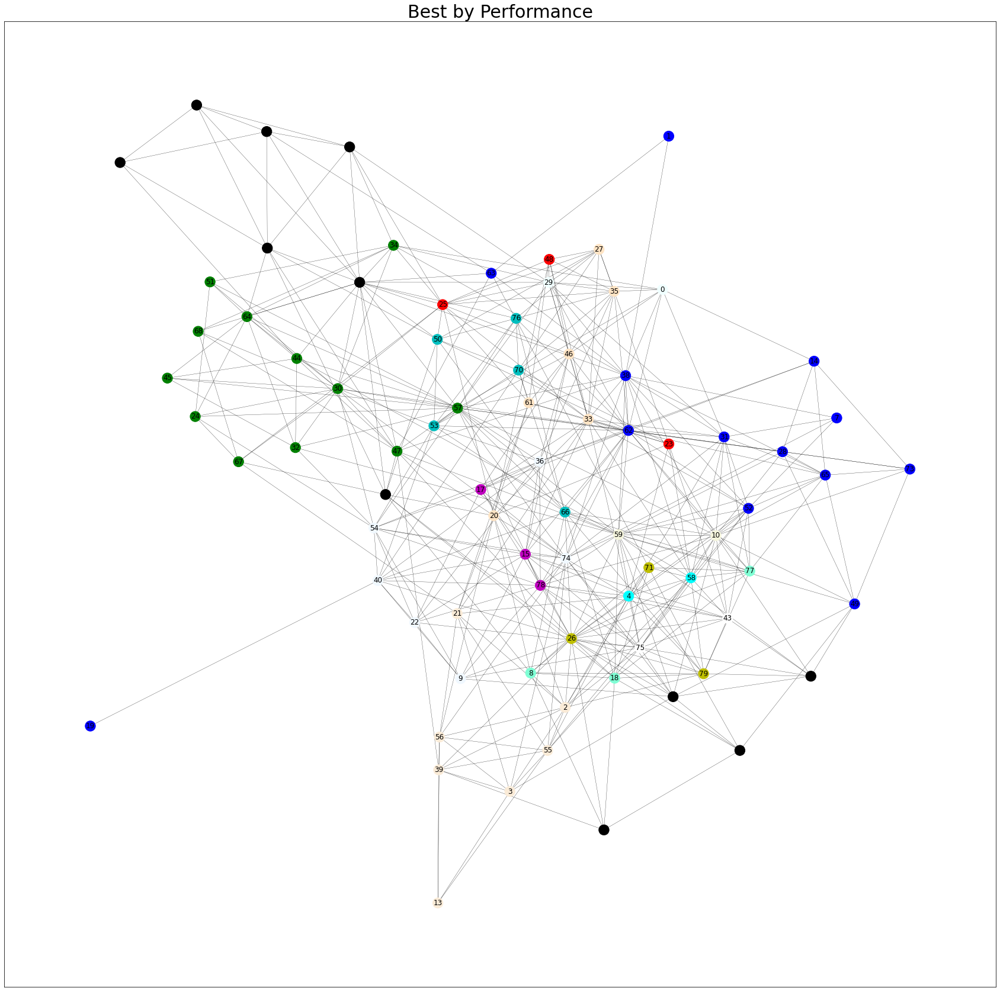

In [403]:
drawCommunities(graph, best_perf_partits_spectral[name], 'Best by Performance')

_Maximum Modularity Clustering:_

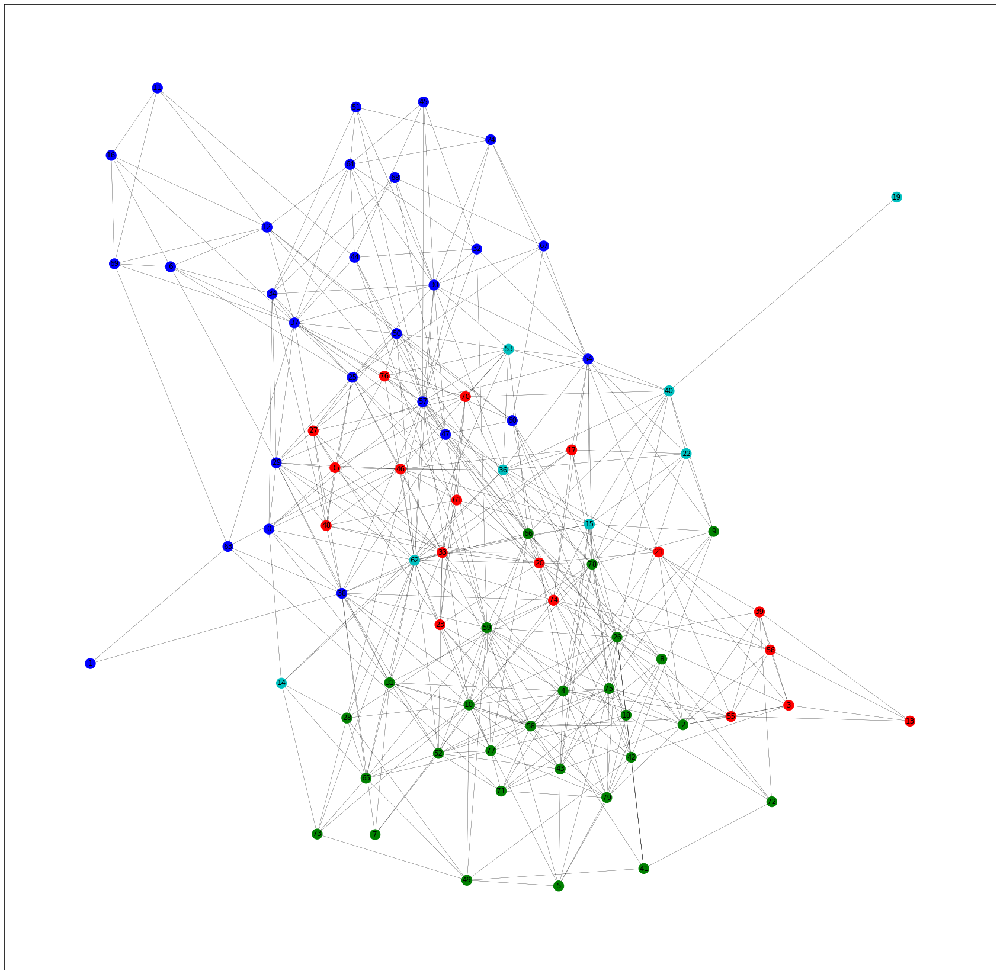

In [404]:
drawCommunities(graph, best_mod_partits_modMax[name], '')

Πίνακας Αποτελεσμάτων:

In [470]:
# resultsAsMarkdownTable('RGG')

| Algorithm | Best Modularity | Size of Partition with best modularity | Best Performance | Size of Partition with best Performance | Calculation Time (s) |
| :-: | :-: | :-: | :-: | :-: | :-: |
|**Girvan-Newman**|0.39609|8|0.90095|33|3.723|
|**Spectral Clustering**|0.34377|6|0.88259|19|0.881|
|**Modularity Maximization**|0.36082|4|0.76139|4|0.054|

Ως προς το Modularity στον RGG όλοι οι αλγόριθμοι πετυχαίνουν κοντινές τιμές, ενώ υπολογίζουν και κοντινά πλήθη κοινοτήτων. Καλύτερος πάντως είναι ο GN. Στο Performance υπερισχύει πάλι ο GN, υπολογίζοντας εδώ αρκετά περισσότερες κοινότητες από τους άλλους δύο και κυρίως τον MM.

Όσον αφορά την οπτικοποίηση, εδώ παρατηρούμε ότι οι κοινότητες σχηματίζονται με αρκετά διαισθητικό τρόπο, με την έννοια ότι υπάρχει τοπικότητα (ομάδες κόμβων με το ίδιο χρώμα σε συγκεκριμένες περιοχές του γραφήματος). Αυτό βεβαια, είναι και αναμενόμενο, καθώς ο RGG έχει έντονα γεωμετρικά χαρακτηριστικά στην κατασκευή του.

#### Οπτικοποίηση κοινοτήτων SW

In [522]:
name, graph = 'SW', SW

_Girvan-Newman Clustering:_

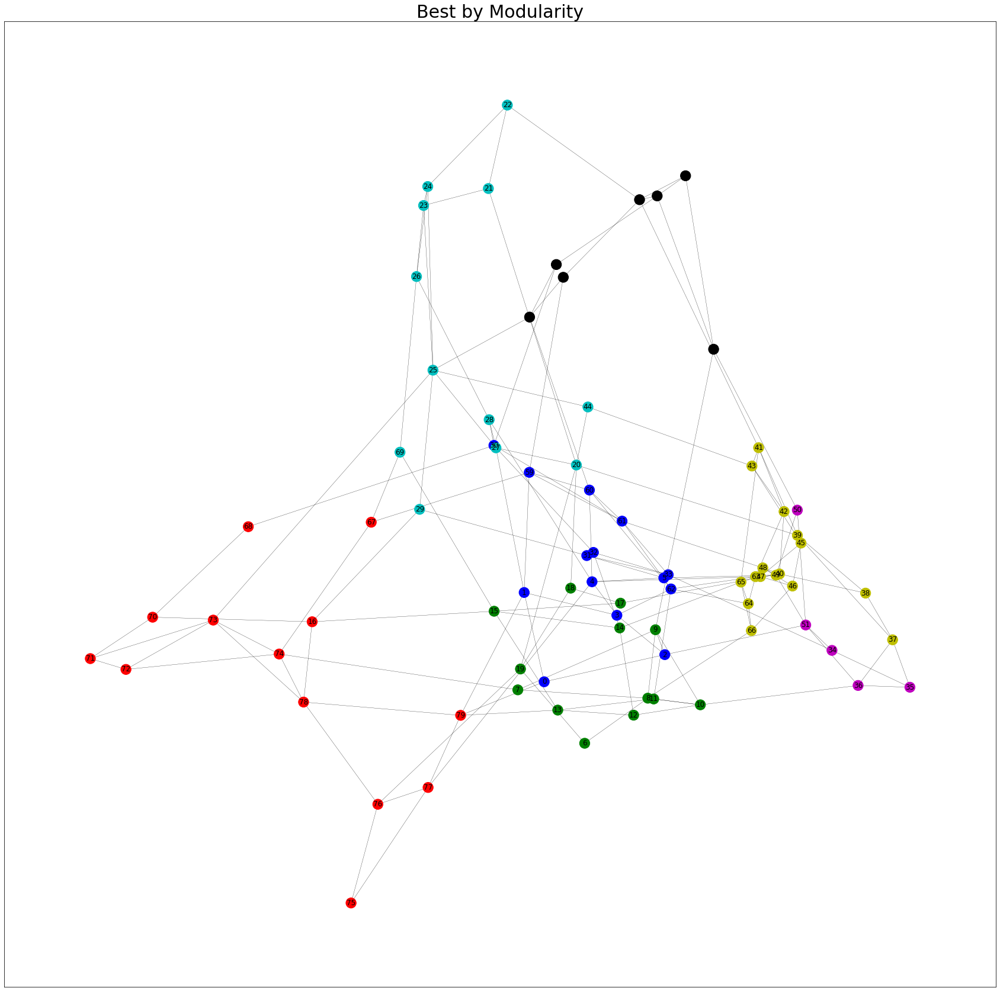

In [523]:
drawCommunities(graph, best_mod_partits_gn[name], 'Best by Modularity', nx.spectral_layout)

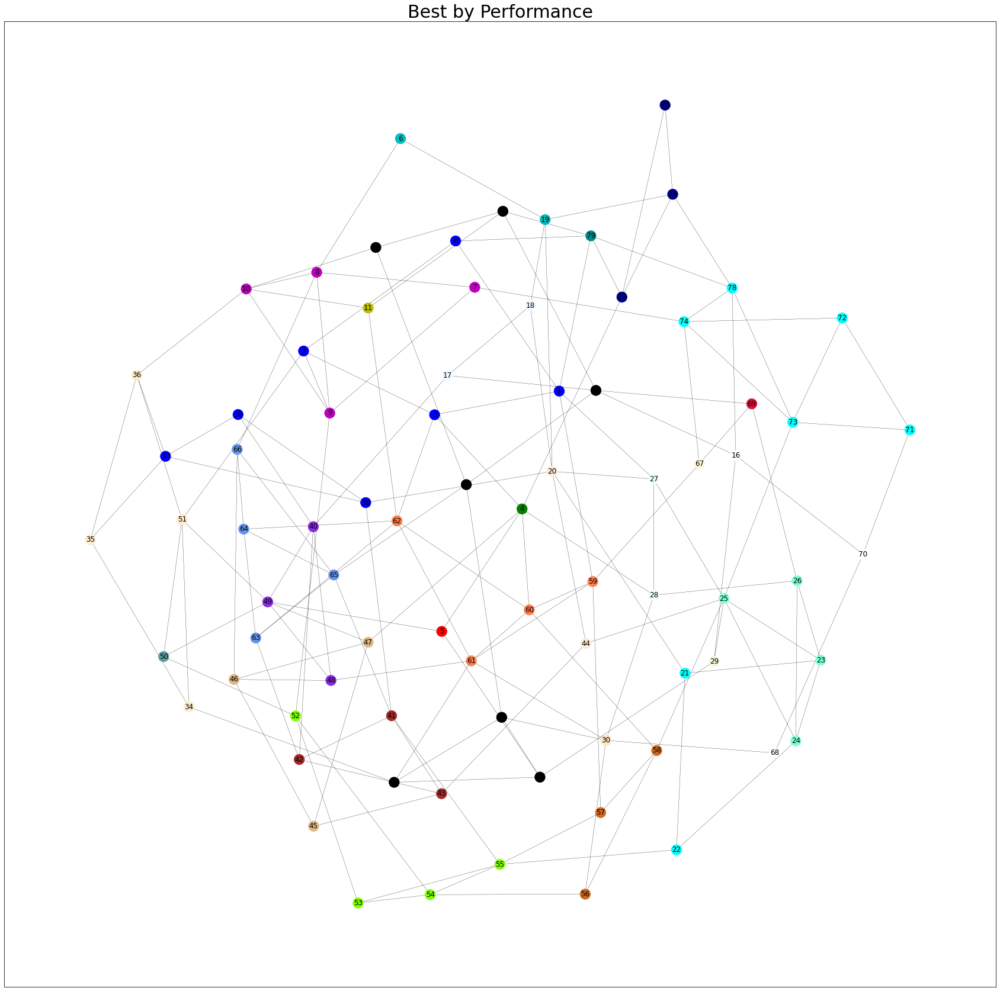

In [526]:
drawCommunities(graph, best_perf_partits_gn[name], 'Best by Performance', layout_func=nx.kamada_kawai_layout)

_Spectral Clustering:_

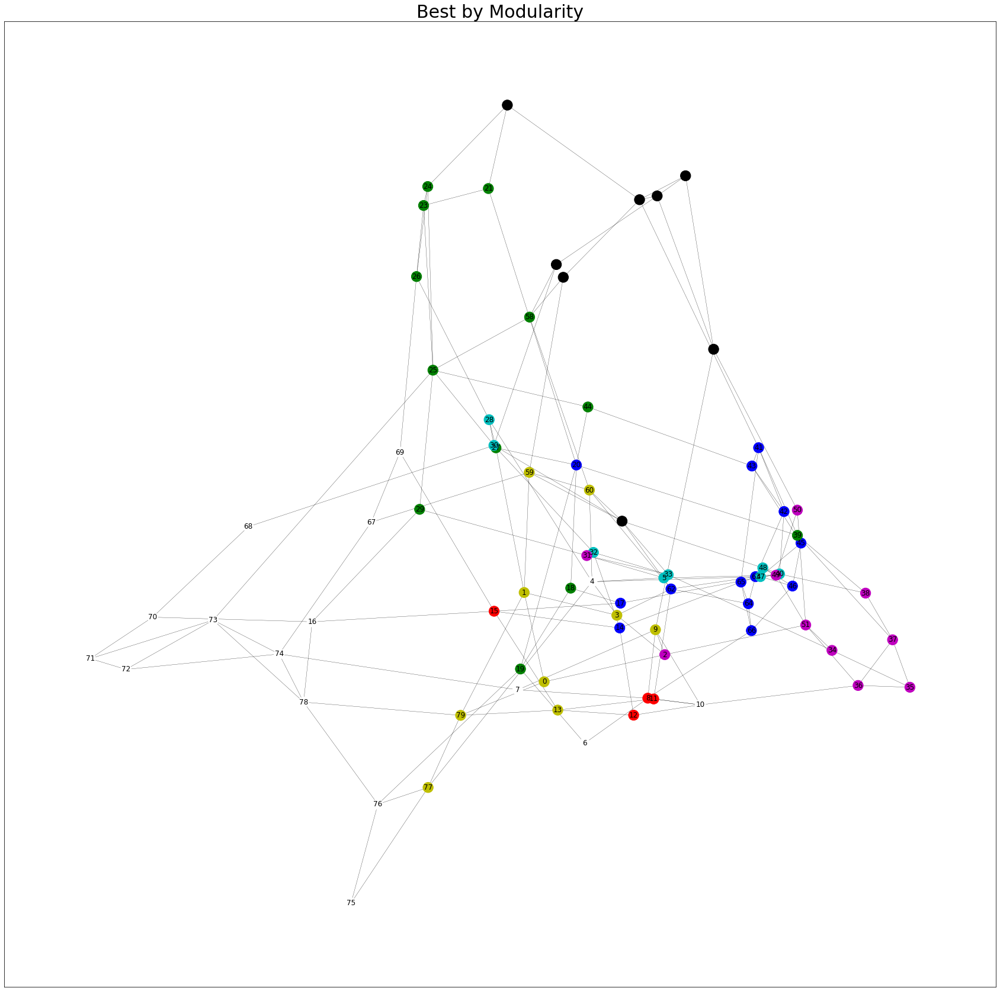

In [527]:
drawCommunities(graph, best_mod_partits_spectral[name], 'Best by Modularity', layout_func=nx.spectral_layout)

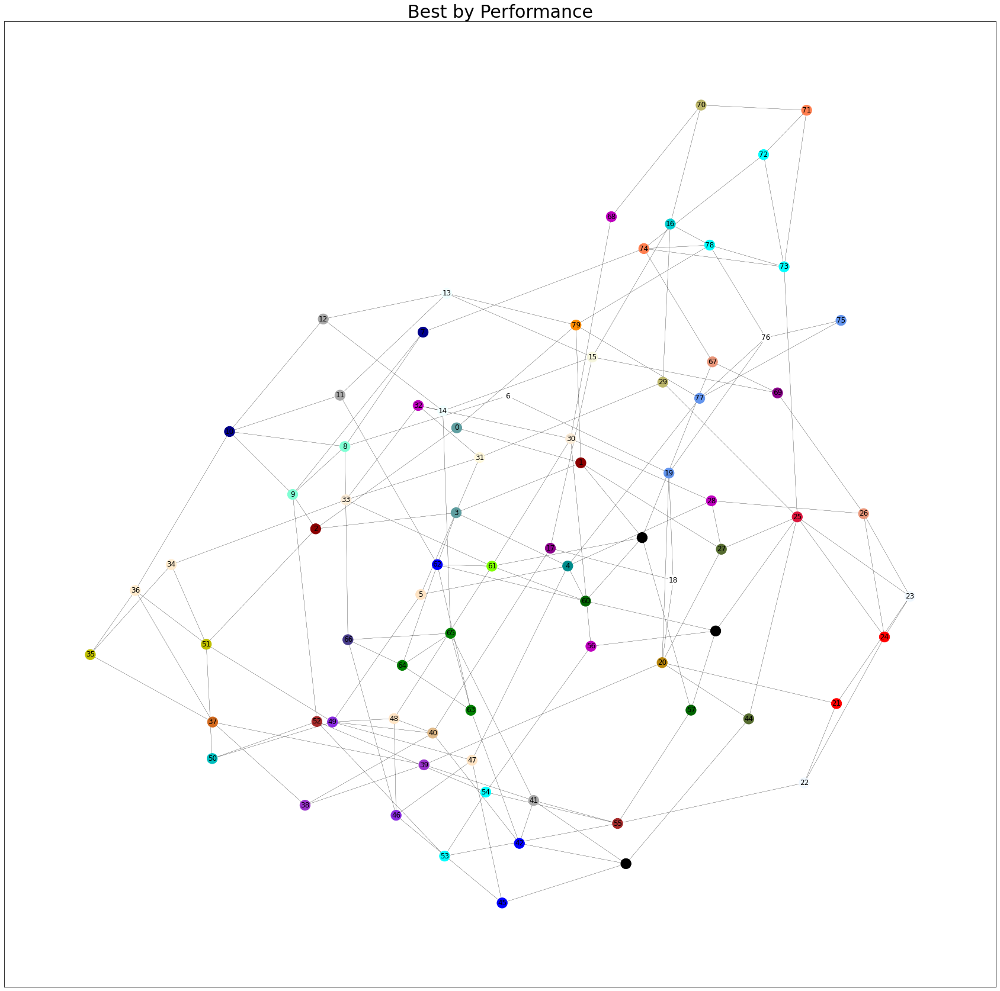

In [531]:
drawCommunities(graph, best_perf_partits_spectral[name], 'Best by Performance')

_Maximum Modularity Clustering:_

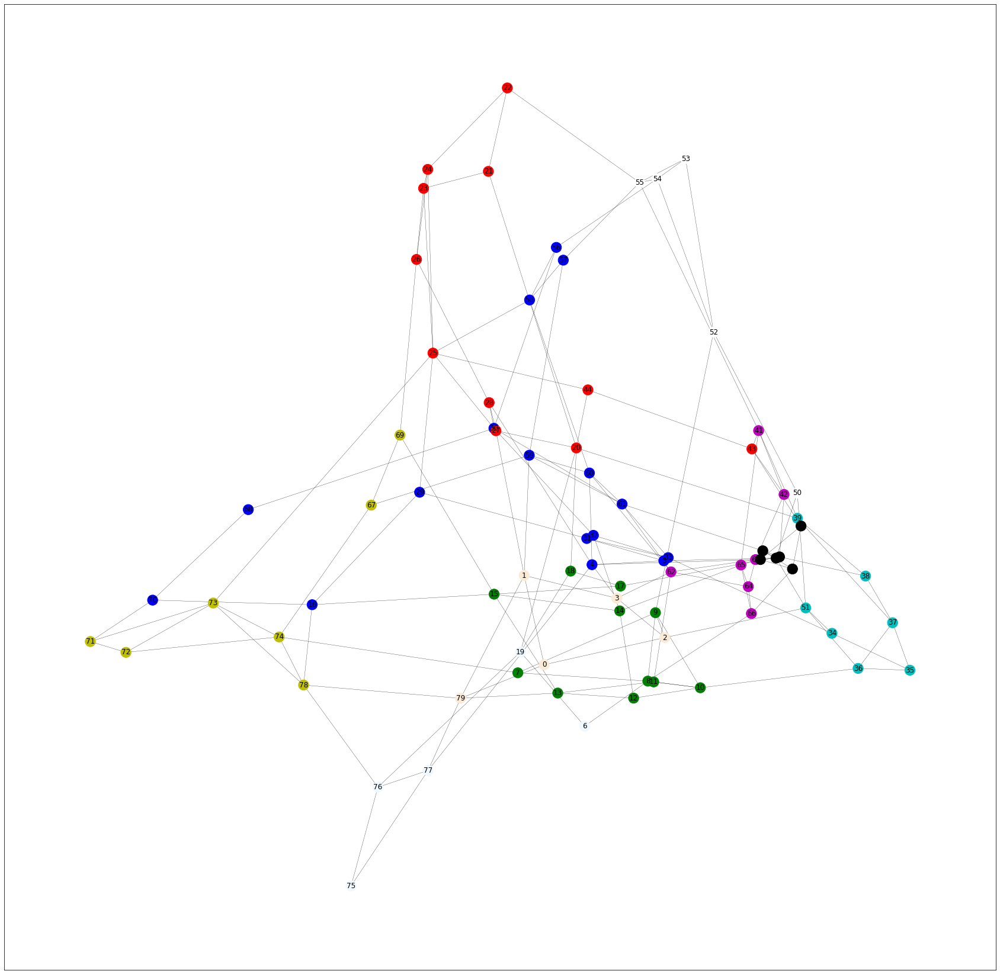

In [532]:
drawCommunities(graph, best_mod_partits_modMax[name], '', layout_func=nx.spectral_layout)

Πίνακας Αποτελεσμάτων:

In [472]:
# resultsAsMarkdownTable('SW')

| Algorithm | Best Modularity | Size of Partition with best modularity | Best Performance | Size of Partition with best Performance | Calculation Time (s) |
| :-: | :-: | :-: | :-: | :-: | :-: |
|**Girvan-Newman**|0.5442|7|0.96677|31|0.988|
|**Spectral Clustering**|0.32445|8|0.94114|48|0.85|
|**Modularity Maximization**|0.53687|10|0.90886|10|0.024|

Στον SW γράφο, υπερισχύει και για τις δύο μετρικές ο GN αλγόριθμος. Για το καλύτερο Modularity, εντοπίζει partition με 7 κοινότητες, ενώ για το καλύτερο Performance, partition με 31 κοινότητες. Σε αυτήν την περίπτωση και οι δύο άλλοι αλγόριθμοι πετυχαίνουν σχετικά κοντινά αποτελέσματα.

Σχετικά με την οπτικοποίηση παρατηρούμε ότι σχηματίζονται σχετικά ισομεγέθης κοινότητες που είναι έντονα συνδεδεμένες εσωτερικά και πιο "ασθενώς" συνεδεδεμένες με τις υπόλοιπες κοινότητες, κάτι που είναι χαρακτηριστικό των SW δικτύων.

#### Οπτικοποίηση κοινοτήτων SF

In [533]:
name, graph = 'SF', SF

_Girvan-Newman Clustering:_

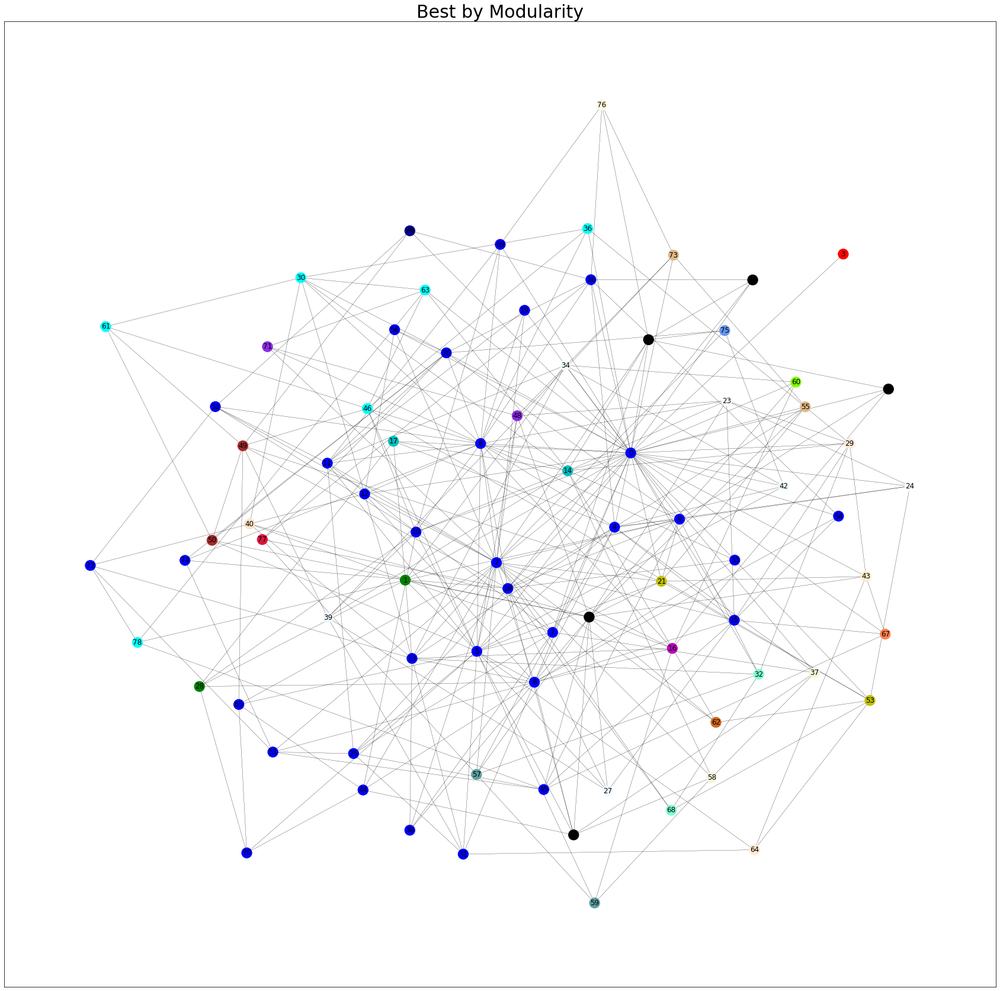

In [537]:
drawCommunities(graph, best_mod_partits_gn[name], 'Best by Modularity', nx.nx_pydot.pydot_layout)

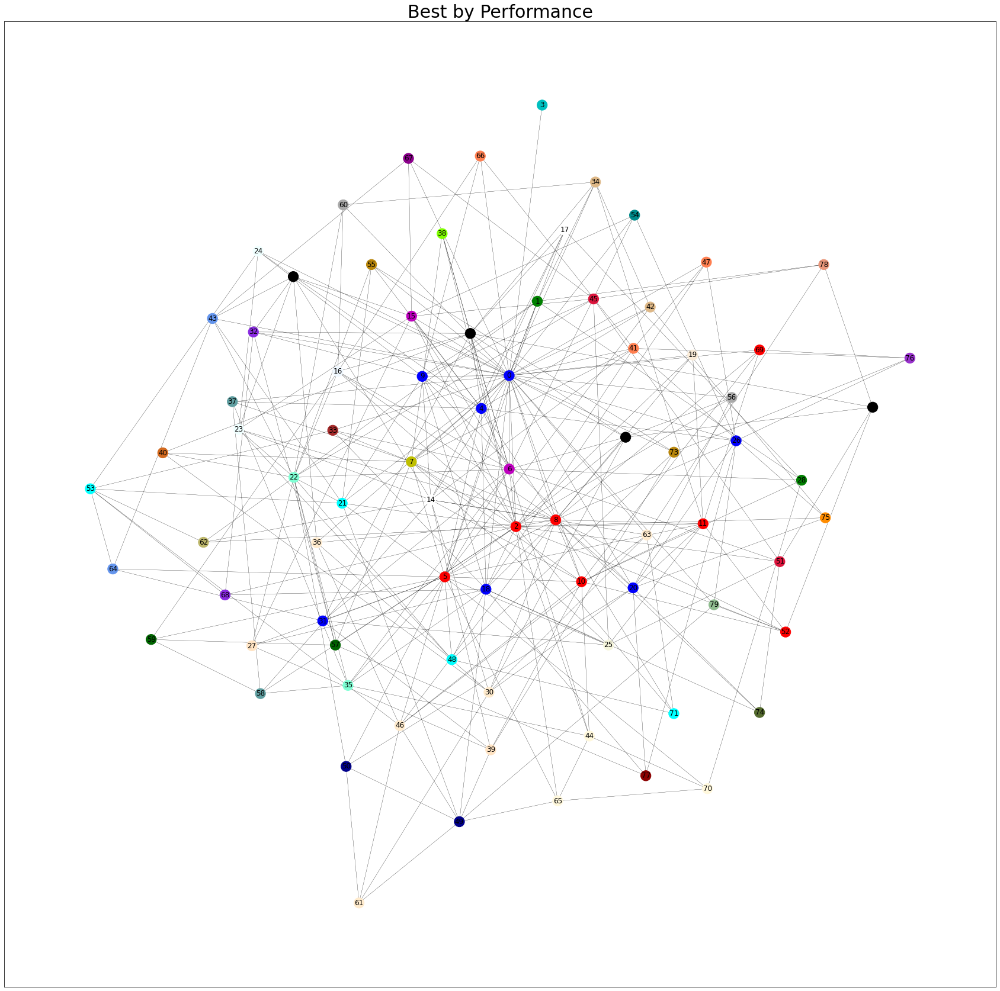

In [538]:
drawCommunities(graph, best_perf_partits_gn[name], 'Best by Performance', nx.kamada_kawai_layout)

_Spectral Clustering:_

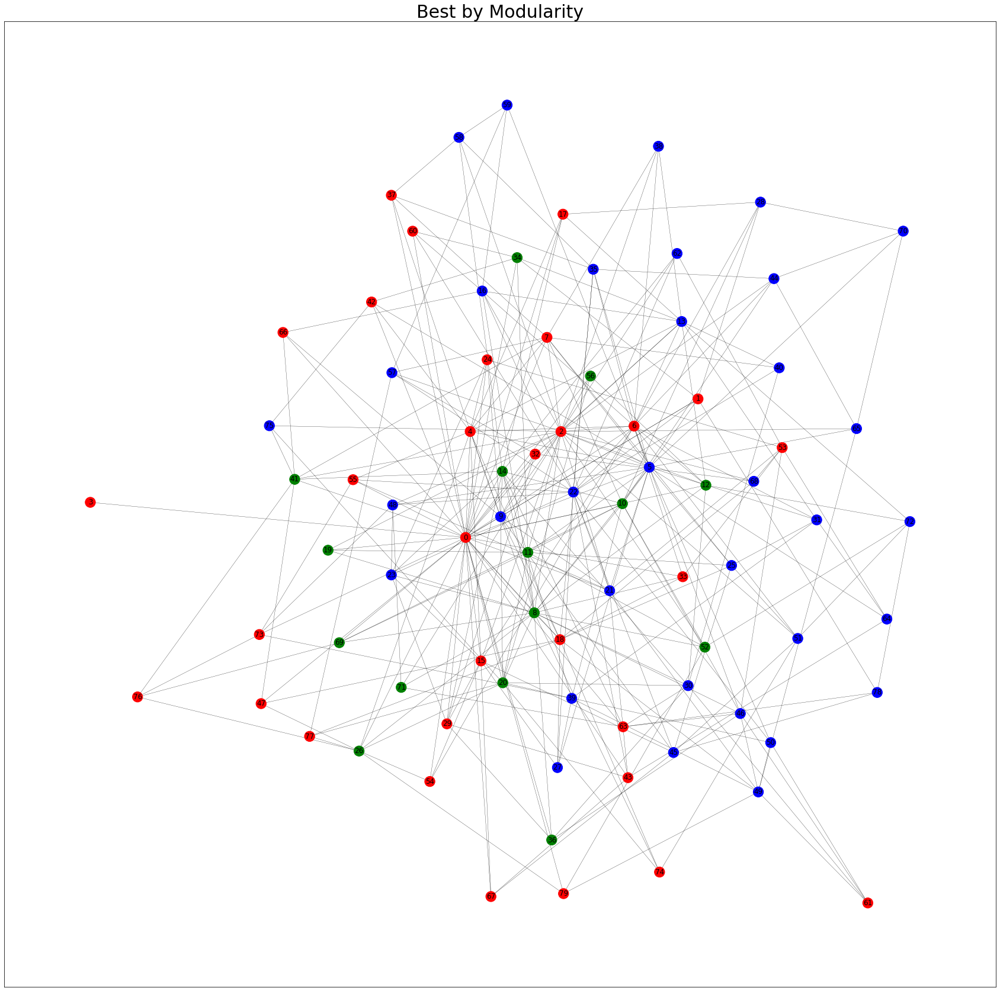

In [539]:
drawCommunities(graph, best_mod_partits_spectral[name], 'Best by Modularity')

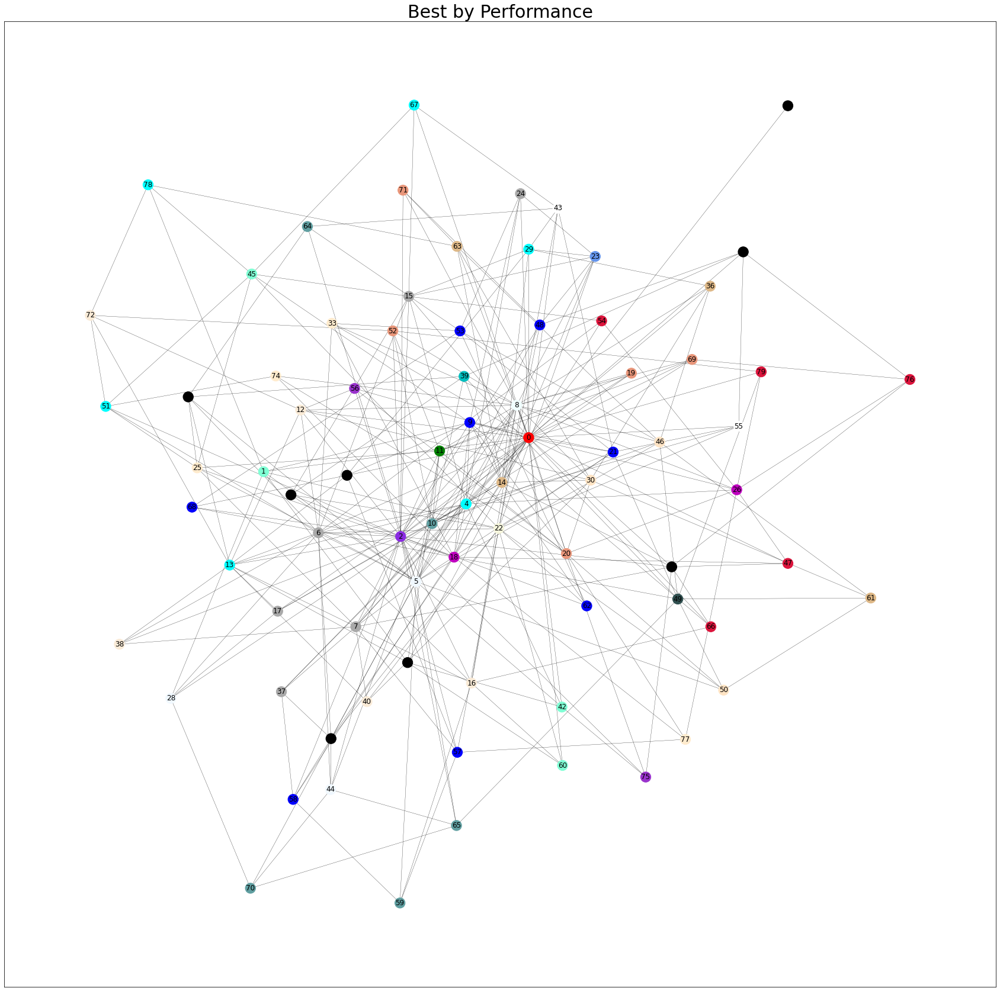

In [540]:
drawCommunities(graph, best_perf_partits_spectral[name], 'Best by Performance')

_Maximum Modularity Clustering:_

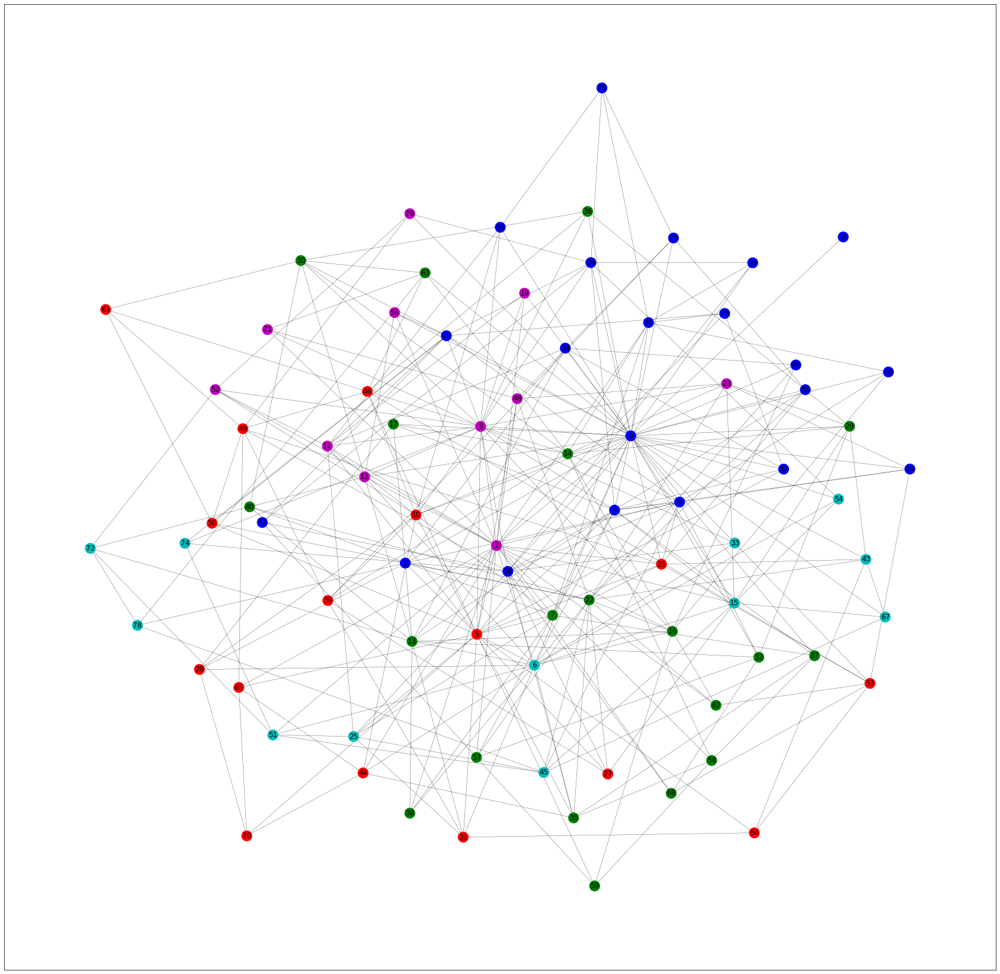

In [541]:
drawCommunities(graph, best_mod_partits_modMax[name], '', layout_func=nx.nx_pydot.pydot_layout)

Πίνακας Αποτελεσμάτων:

In [542]:
# resultsAsMarkdownTable('SF')


| Algorithm | Best Modularity | Size of Partition with best modularity | Best Performance | Size of Partition with best Performance | Calculation Time (s) |
| :-: | :-: | :-: | :-: | :-: | :-: |
|**Girvan-Newman**|0.13638|30|0.91741|43|3.114|
|**Spectral Clustering**|0.08721|3|0.86899|49|0.891|
|**Modularity Maximization**|0.27|5|0.79399|5|0.049|



Για τον SF, το καλύτερο Modularity επιτυγχάνει ο MM με αρκετή διαφορά από τους άλλους δύο και εντοπίζοντας 5 κοινότητες. Από την άλλη, το καλύτερο Performance επιτυγχάνεται από τον GN, με πολύ περισσότερες κοινότητες (43).

Στην οπτικοποίηση γίνεται αισθητή η παρουσία των κόμβων hubs που είναι χαρακτηριστικό των SF δικτύων. Αυτοί στις περισσότερες περιπτώσεις έχουν σχεδιαστεί στην κεντρική περιοχή του γραφήματος και παρουσιάζουν μεγάλη πυκνότητα ακμών σε σχέση με λιγότερο κυρίαρχους κόμβους στης περιφερειακή περιχή του γραφήματος που έχουν σημαντικά λιγότερες ακμές.

**Παρακάτω παρουσιάζουμε τα αποτελέσματα των διαφόρων αλγορίθμων για όλους τους γράφους και με μορφή διαγράμματος**

In [105]:
def plotBarChart(x, ylist, cols, labs, tit, xlab, ylab, figsize=(15,8), subplots=1, x2=None, ylist2=None):
    plt.clf()
    
    if subplots == 1:
        fig, ax = plt.subplots(figsize=figsize)
        # offsets of bar plots
        xaxis = np.arange(len(x))
        totalWidth = len(ylist)*0.2-0.2
        offset = [-(totalWidth/2)+i*0.2 for i in range(len(ylist))]

        for i in range(len(ylist)):
            fig = plt.bar(xaxis+offset[i], ylist[i], color=cols[i], label=labs[i], width=0.2)

        # correct the xticklabels
        ax.set_xticks(xaxis)
        ax.set_xticklabels(x)

        plt.legend()
        plt.xlabel(xlab, fontsize=15)
        plt.ylabel(ylab, fontsize=15)
        plt.title(tit, fontsize=20)
        plt.grid(axis='y')
        
    else:
        fig, [ax,ax2] = plt.subplots(nrows=1, ncols=2, figsize=figsize)
        fig.suptitle(tit, fontsize=20)
        
        plt.subplot(1,2,1)
        # barplot 1
        xaxis = np.arange(len(x))
        # offsets of bar plots
        totalWidth = len(ylist)*0.2-0.2
        offset = [-(totalWidth/2)+i*0.2 for i in range(len(ylist))]

        for i in range(len(ylist)):
            fig = ax.bar(xaxis+offset[i], ylist[i], color=cols[i], label=labs[i], width=0.2)

        # correct the xticklabels
        ax.set_xticks(xaxis)
        ax.set_xticklabels(x)
        ax.legend()
        plt.xlabel(xlab, fontsize=15)
        plt.ylabel(ylab, fontsize=15)
        plt.grid(axis='y')
        
        
        # barplot 2
        plt.subplot(1,2,2)
        xaxis2 = np.arange(len(x2))
        # offsets of bar plots
        totalWidth = len(ylist2)*0.2-0.2
        offset = [-(totalWidth/2)+i*0.2 for i in range(len(ylist2))]

        for i in range(len(ylist2)):
            fig = ax2.bar(xaxis2+offset[i], ylist2[i], color=cols[i], label=labs[i], width=0.2)

        # correct the xticklabels
        ax2.set_xticks(xaxis2)
        ax2.set_xticklabels(x2)
        ax2.legend()
        plt.xlabel(xlab, fontsize=15)
        plt.ylabel(ylab, fontsize=15)    
        plt.grid(axis='y')

**Συγκριτικά αποτελέσματα ως προς το Modularity για τους διάφορους αλγορίθμους:**

<Figure size 432x288 with 0 Axes>

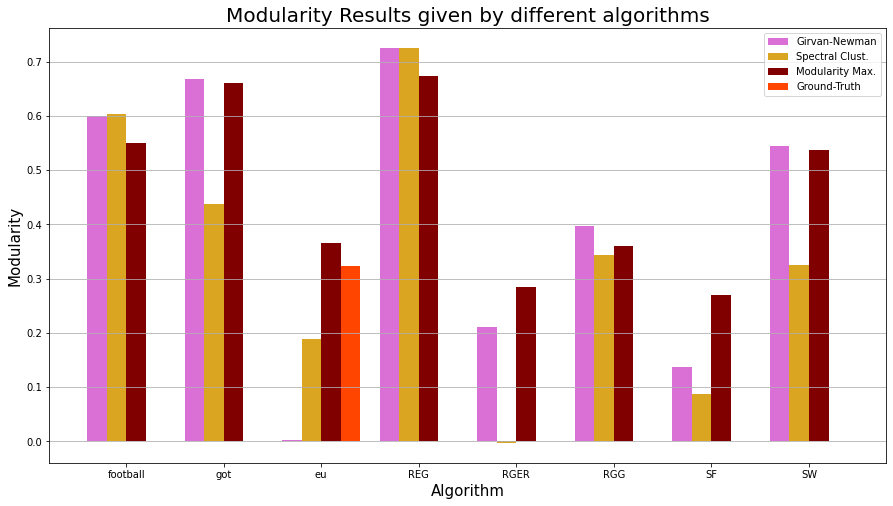

In [219]:
def fraction2percentage(frac):
    return round(frac*100, 2)

xaxis = list(best_mods_modMax.keys())
yaxis = [best_mods_gn.values(), best_mods_spectral.values(), best_mods_modMax.values()]

# yaxis = [list(map(fraction2percentage, best_mods_gn.values())),
#          list(map(fraction2percentage, best_mods_spectral.values())), 
#          list(map(fraction2percentage,best_mods_modMax.values()))
#         ]

# add mod results of ground-truth partition only for EU (for the other graphs -> 0)
yaxis.append([(0 if key != 'eu' else best_mod_gt) for key in best_perf_partits_gn.keys()])

plotBarChart(xaxis, 
             yaxis, 
             ['orchid', 'goldenrod', 'maroon', 'orangered'], 
             ['Girvan-Newman', 'Spectral Clust.', 'Modularity Max.', 'Ground-Truth'], 
             'Modularity Results given by different algorithms',
             'Algorithm',
             'Modularity'            
            )

**Συγκριτικά αποτελέσματα ως προς το Performance για τους διάφορους αλγορίθμους:**

<Figure size 432x288 with 0 Axes>

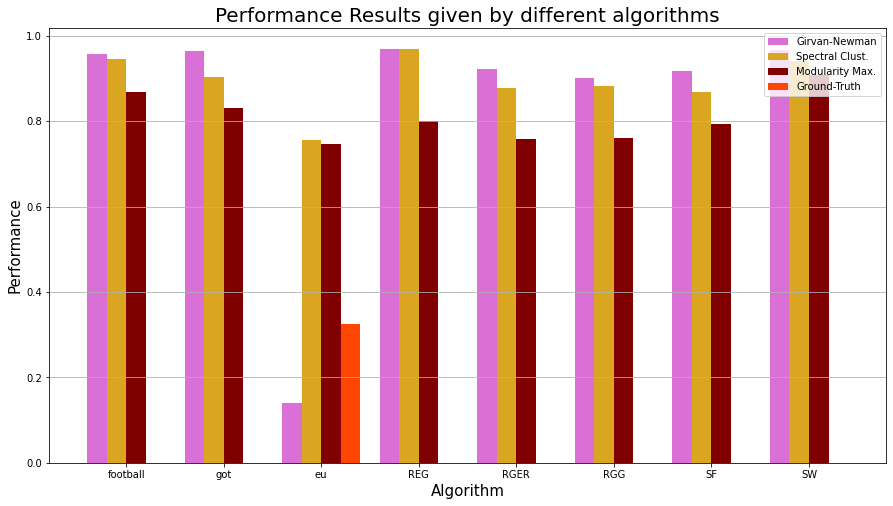

In [217]:
xaxis = list(best_perfs_modMax.keys())
yaxis = [best_perfs_gn.values(), best_perfs_spectral.values(), best_perfs_modMax.values()]

# add performance results of ground-truth partition only for EU (for the other graphs -> 0)
yaxis.append([(0 if key != 'eu' else best_perf_gt) for key in best_perf_partits_gn.keys()])

plotBarChart(xaxis, 
             yaxis, 
             ['orchid', 'goldenrod', 'maroon', 'orangered'], 
             ['Girvan-Newman', 'Spectral Clust.', 'Modularity Max.', 'Ground-Truth'], 
             'Performance Results given by different algorithms',
             'Algorithm',
             'Performance'            
            )

**Σύγκριση του Χρόνου Εκτέλεσης για τους διάφορους αλγορίθμους:**

(εδώ κάνουμε χωριστό διάγραμμα για τους χρόνους του EU, γιατί αυτοί ξεφεύγουν κατά τάξεις μεγέθους από τους υπόλοιπους και χαλάνε την κλίμακα αν μπουν σε κοινό διάγραμμα)

<Figure size 432x288 with 0 Axes>

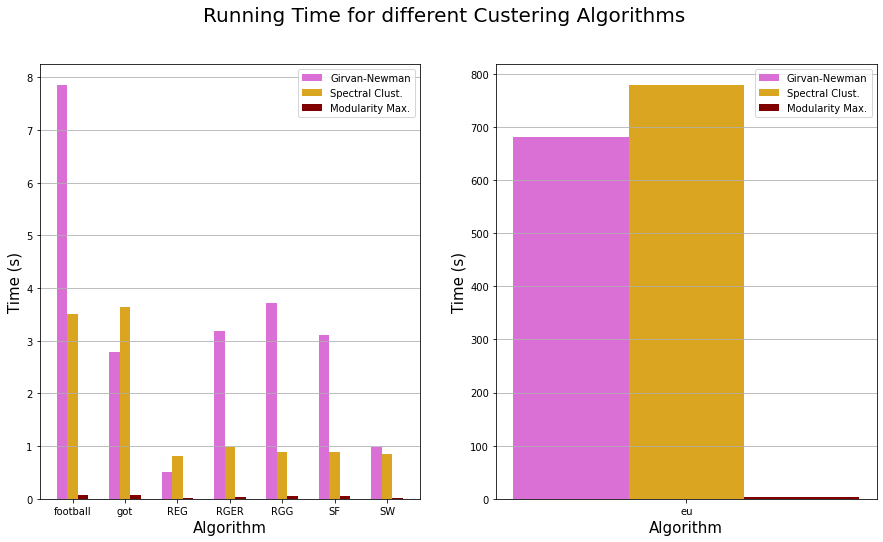

In [108]:
xaxis = [key for key in time_gn.keys() if key!= 'eu']
yaxis = [[time_gn[key] for key in xaxis], 
         [time_spectral[key] for key in xaxis], 
         [time_modMax[key] for key in xaxis]
        ]

plotBarChart(xaxis, 
             yaxis, 
             ['orchid', 'goldenrod', 'maroon'], 
             ['Girvan-Newman', 'Spectral Clust.', 'Modularity Max.'], 
             'Running Time for different Custering Algorithms',
             'Algorithm',
             'Time (s)',
             subplots=2,
             x2=['eu'],
             ylist2=[time_gn['eu'], time_spectral['eu'], time_modMax['eu']], 
            )